In [1]:
rm(list=ls())
library(scran)
library(scds)
library(scDblFinder)
library(Seurat)
library(Matrix)
library(cowplot) 
library(dplyr)
library(clustree)
library(DT)
library(pheatmap)
library(RColorBrewer)
library(gplots)
library(pracma)
library(monocle)
# library(tidyverse)

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: 'BiocGenerics'


The following objects are masked from 'package:parallel':

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from 'package:stats':

    IQR, mad, sd, var, xtabs


The following objects are masked from 'package:base':

    Filter, Find, Map, Position, Reduce, anyDuplicated, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
   

<h2>1.Seurat Combine for 4 data(CL10)</h2>

In [2]:
data_list = c("CL10P", "CL10D4", "CL10D7","CL10D14")
for (data in data_list){
    load(file = paste0('/mnt/isilonX200/scRNA/Project_1/Result/', data, '.qc.Rdata'))
}

In [4]:
color_style = c("CL1-0-P-4" = "#14c770", "CL1-0-D4" = "#f5c242", "CL1-0-D7" = "#e86b5d", "CL1-0-D14" = "#54d1cd")
order_list = c("CL1-0-P-4","CL1-0-D4","CL1-0-D7","CL1-0-D14")

In [3]:
CL10 <- merge(CL10P, y=c(CL10D4, CL10D7, CL10D14))

In [202]:
CL10@meta.data$condition<-factor(CL10@meta.data$condition, levels = order_list)

In [4]:
str(CL10)

Formal class 'Seurat' [package "Seurat"] with 12 slots
  ..@ assays      :List of 2
  .. ..$ RNA   :Formal class 'Assay' [package "Seurat"] with 8 slots
  .. .. .. ..@ counts       :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int [1:75800282] 14 21 22 26 27 39 41 43 45 47 ...
  .. .. .. .. .. ..@ p       : int [1:14170] 0 5160 10430 16096 21800 28212 34654 41003 47064 52109 ...
  .. .. .. .. .. ..@ Dim     : int [1:2] 33538 14169
  .. .. .. .. .. ..@ Dimnames:List of 2
  .. .. .. .. .. .. ..$ : chr [1:33538] "MIR1302-2HG" "FAM138A" "OR4F5" "AL627309.1" ...
  .. .. .. .. .. .. ..$ : chr [1:14169] "AAACCTGAGGATATAC-CL1-0-P-4" "AAACCTGCACAGTCGC-CL1-0-P-4" "AAACCTGCACATTTCT-CL1-0-P-4" "AAACCTGGTTAAAGAC-CL1-0-P-4" ...
  .. .. .. .. .. ..@ x       : num [1:75800282] 1 2 1 43 13 8 1 5 2 1 ...
  .. .. .. .. .. ..@ factors : list()
  .. .. .. ..@ data         :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int 

In [5]:
tail(CL10[[]])

,orig.ident,nCount_RNA,nFeature_RNA,condition,percent.MT
,<chr>,<dbl>,<int>,<chr>,<dbl>
TTTGTCAGTCCATCCT-CL1-0-D14,Project_1,40201,5358,CL1-0-D14,3.288475
TTTGTCAGTTCATGGT-CL1-0-D14,Project_1,39127,4861,CL1-0-D14,4.171033
TTTGTCATCCACTCCA-CL1-0-D14,Project_1,68971,6349,CL1-0-D14,3.820446
TTTGTCATCGTTTAGG-CL1-0-D14,Project_1,31085,4133,CL1-0-D14,6.211999
TTTGTCATCTACCTGC-CL1-0-D14,Project_1,45455,5028,CL1-0-D14,3.368166
TTTGTCATCTTGGGTA-CL1-0-D14,Project_1,44551,5055,CL1-0-D14,4.426388


<h2>2.Data Visualization</h2>

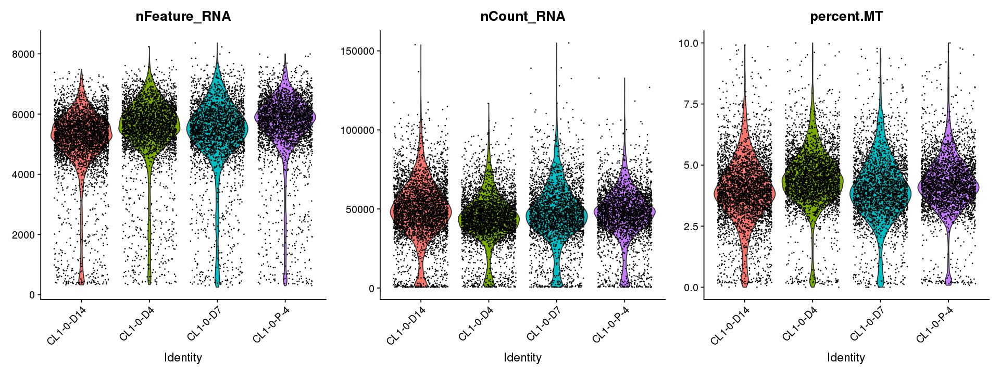

In [6]:
options(repr.plot.width=16, repr.plot.height=6)
VlnPlot(CL10, features = c("nFeature_RNA", "nCount_RNA", "percent.MT"), 
        ncol = 3, group.by = "condition", pt.size = 0.1, assay = "logCPM" )

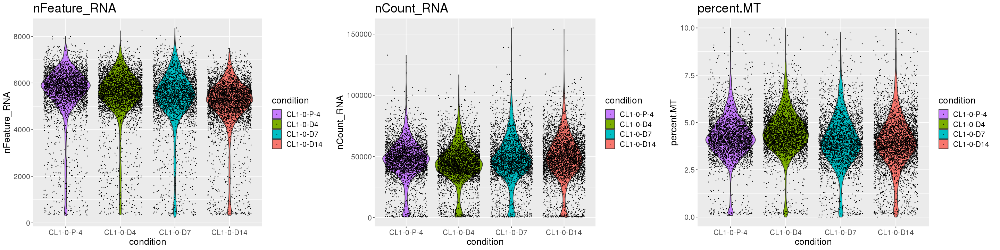

In [7]:
options(repr.plot.width=24, repr.plot.height=6)
vgp1 <- ggplot(CL10[[]], aes(x=condition, y=nFeature_RNA, fill=condition))+
        geom_violin()+
        geom_point(position="jitter", size=0.1)+
        theme(text = element_text(size = 16), plot.title = element_text(size=22))+
        scale_x_discrete(limits = order_list)+
        scale_fill_discrete(breaks = order_list)+
        labs(title = "nFeature_RNA")
vgp2 <- ggplot(CL10[[]], aes(x=condition, y=nCount_RNA, fill=condition))+
        geom_violin()+
        geom_point(position="jitter", size=0.1)+
        theme(text = element_text(size = 16), plot.title = element_text(size=22))+
        scale_x_discrete(limits = order_list)+
        scale_fill_discrete(breaks = order_list)+
        labs(title = "nCount_RNA")
vgp3 <- ggplot(CL10[[]], aes(x=condition, y=percent.MT, fill=condition))+
        geom_violin()+
        geom_point(position="jitter", size=0.1)+
        theme(text = element_text(size = 16), plot.title = element_text(size=22))+
        scale_x_discrete(limits = order_list)+
        scale_fill_discrete(breaks = order_list)+
        labs(title = "percent.MT")
plot_grid(vgp1, vgp2, vgp3, ncol=3)

<h4><u>Finding height expression gene </u></h4>

[1] "TFPI2"  "TIMP1"  "VCX2"   "NTS"    "KRT18"  "S100A6" "AGR2"   "GDF15" 
 [9] "FST"    "GNG11"

Warning message:
"Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session."
Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."
Warning message:
"Transformation introduced infinite values in continuous x-axis"
Warning message:
"Transformation introduced infinite values in continuous x-axis"


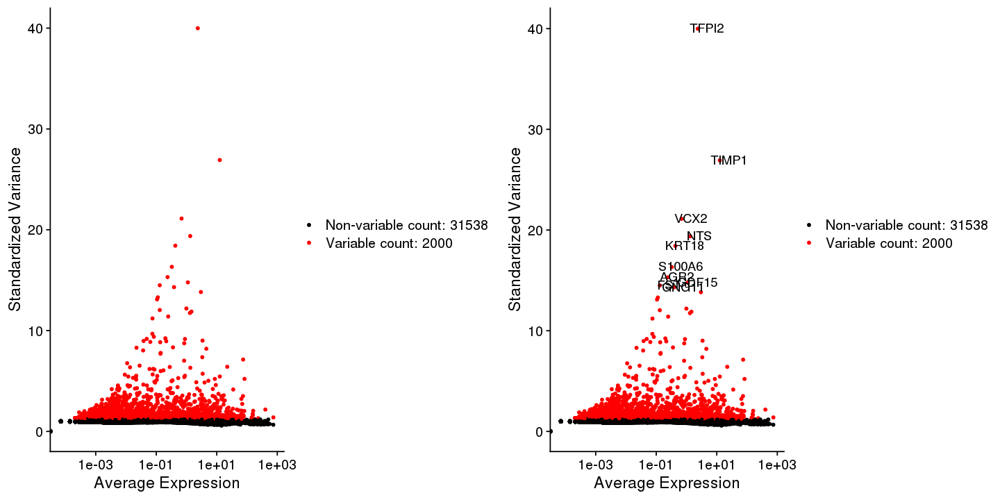

In [8]:
CL10 <- FindVariableFeatures(CL10, selection.method = "vst", nfeatures = 2000)
top10 <- head(VariableFeatures(CL10), 10)
top10
plot1 <- VariableFeaturePlot(CL10)
plot2 <- LabelPoints(plot = plot1, points = top10)
options(repr.plot.width=12, repr.plot.height=6)
CombinePlots(plots = list(plot1, plot2))

In [9]:
CL10 <- ScaleData(object = CL10, features = VariableFeatures(CL10), verbose = FALSE)

In [10]:
cc <- CL10[[]] %>% group_by(condition) %>% summarise(cell_count = length(nCount_RNA)) 
cc[c(4,2,3,1),]

condition,cell_count
<chr>,<int>
CL1-0-P-4,3405
CL1-0-D4,3679
CL1-0-D7,3059
CL1-0-D14,4026


In [11]:
str(CL10)

Formal class 'Seurat' [package "Seurat"] with 12 slots
  ..@ assays      :List of 2
  .. ..$ RNA   :Formal class 'Assay' [package "Seurat"] with 8 slots
  .. .. .. ..@ counts       :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int [1:75800282] 14 21 22 26 27 39 41 43 45 47 ...
  .. .. .. .. .. ..@ p       : int [1:14170] 0 5160 10430 16096 21800 28212 34654 41003 47064 52109 ...
  .. .. .. .. .. ..@ Dim     : int [1:2] 33538 14169
  .. .. .. .. .. ..@ Dimnames:List of 2
  .. .. .. .. .. .. ..$ : chr [1:33538] "MIR1302-2HG" "FAM138A" "OR4F5" "AL627309.1" ...
  .. .. .. .. .. .. ..$ : chr [1:14169] "AAACCTGAGGATATAC-CL1-0-P-4" "AAACCTGCACAGTCGC-CL1-0-P-4" "AAACCTGCACATTTCT-CL1-0-P-4" "AAACCTGGTTAAAGAC-CL1-0-P-4" ...
  .. .. .. .. .. ..@ x       : num [1:75800282] 1 2 1 43 13 8 1 5 2 1 ...
  .. .. .. .. .. ..@ factors : list()
  .. .. .. ..@ data         :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int 

<h2>3.Dimensional Reduction</h2>

<h4><u>PCA</u></h4>

In [12]:
CL10@active.assay

[1] "RNA"

In [13]:
DefaultAssay(object = CL10) <- "RNA"
options(repr.plot.width = 8, repr.plot.height = 8)
CL10 <- RunPCA(object = CL10, features = VariableFeatures(CL10), npcs = 100, verbose = FALSE)

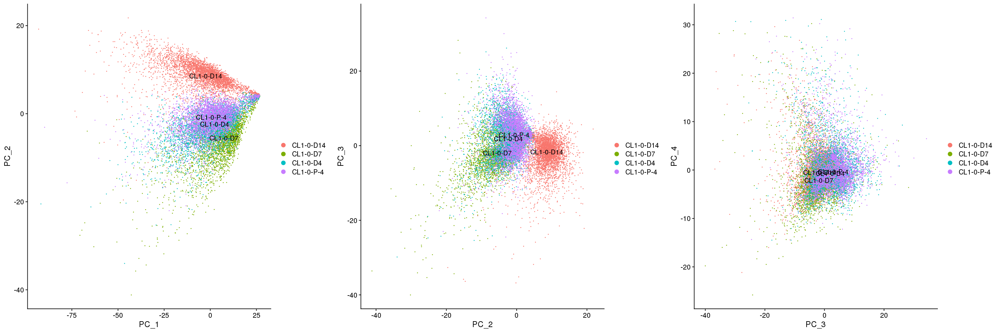

In [14]:
options(repr.plot.width=24, repr.plot.height=8)
dimp1 <- DimPlot(object = CL10, reduction = "pca", group.by = "condition", order = order_list, label = TRUE)
dimp2 <- DimPlot(object = CL10, reduction = "pca", group.by = "condition", dims = c(2:3), order = order_list, label = TRUE)
dimp3 <- DimPlot(object = CL10, reduction = "pca", group.by = "condition", dims = c(3:4), order = order_list, label = TRUE)
plot_grid(dimp1, dimp2, dimp3, ncol=3)

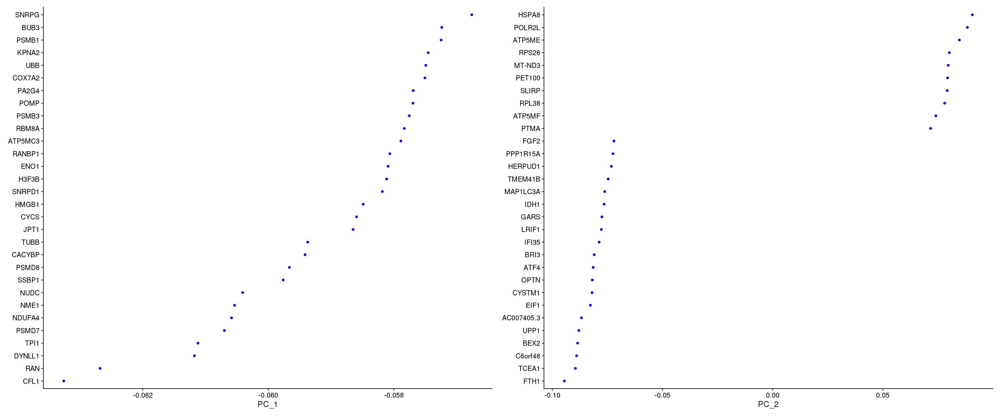

In [15]:
options(repr.plot.width=24, repr.plot.height=10)
VizDimLoadings(CL10, dims = 1:2)

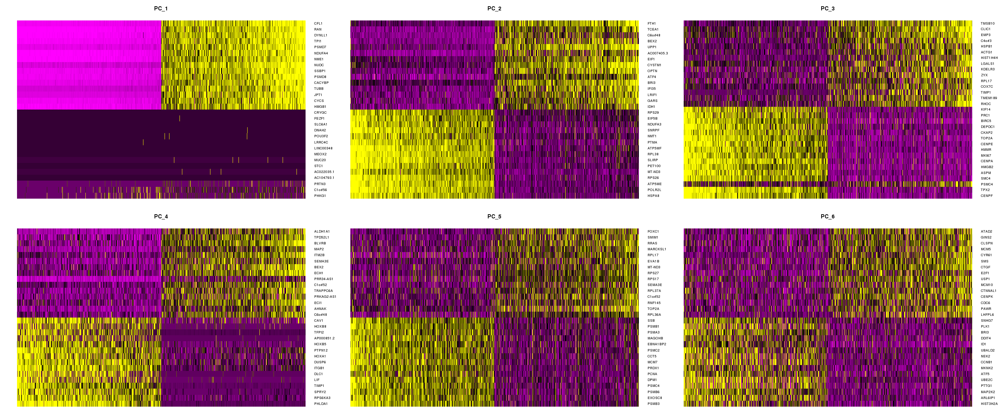

In [16]:
DimHeatmap(CL10, dims = 1:6, cells = 1000, balanced = TRUE)

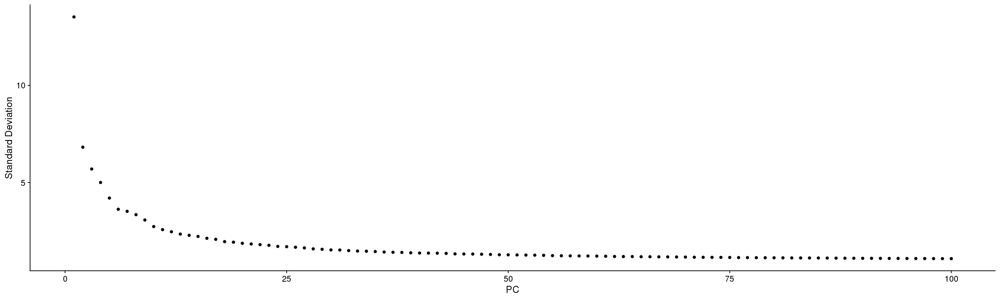

In [17]:
options(repr.plot.width=20, repr.plot.height=6)
ElbowPlot(CL10, ndims = 100, reduction = "pca")


Attaching package: 'future'


The following object is masked from 'package:SummarizedExperiment':

    values


The following object is masked from 'package:GenomicRanges':

    values


The following object is masked from 'package:IRanges':

    values


The following object is masked from 'package:S4Vectors':

    values


Warning message:
"Removed 163379 rows containing missing values (geom_point)."


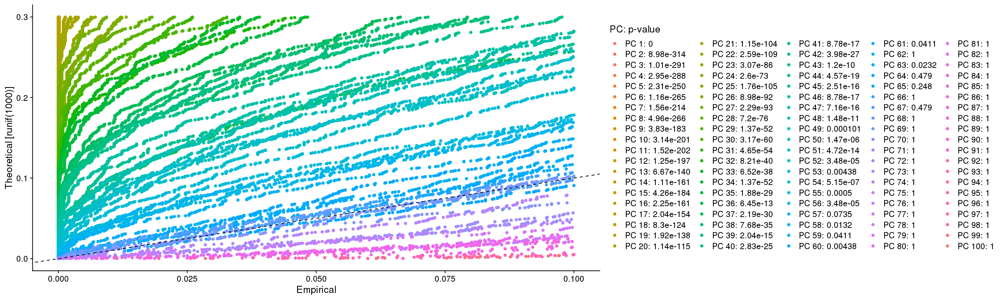

In [18]:
library(future)
plan("multiprocess", workers = 64)
CL10 <- JackStraw(CL10, num.replicate = 300, dims = 100)
CL10 <- ScoreJackStraw(CL10, dims = 1:100)
JackStrawPlot(CL10, dims = 1:100)

<h2>4.Clustering</h2>

In [19]:
# find the best resolution
pc <- 61
#非線性降维（UMAP/tSNE)基於PCA空間中的歐氏距離计算nearest neighbor graph,優化任意两个细胞間的距離權重
resolutions <- seq(0, 1.2, 0.1) 
#優化模型,resolution參數決定下游聚類分析得到的分群數,3K左右的细胞,設為0.4-1.2能得到較好的结果(官方说明)；如果數據量增大,參數也應該適當增大
CL10 <- FindNeighbors(object = CL10, reduction = "pca", dims = 1:pc)
CL10 <- FindClusters(CL10, resolution = resolutions)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 1.0000
Number of communities: 1
Elapsed time: 1 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9486
Number of communities: 4
Elapsed time: 2 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9231
Number of communities: 6
Elapsed time: 2 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9041
Number of communities: 8
Elapsed time: 2 seconds
Modularity Optim

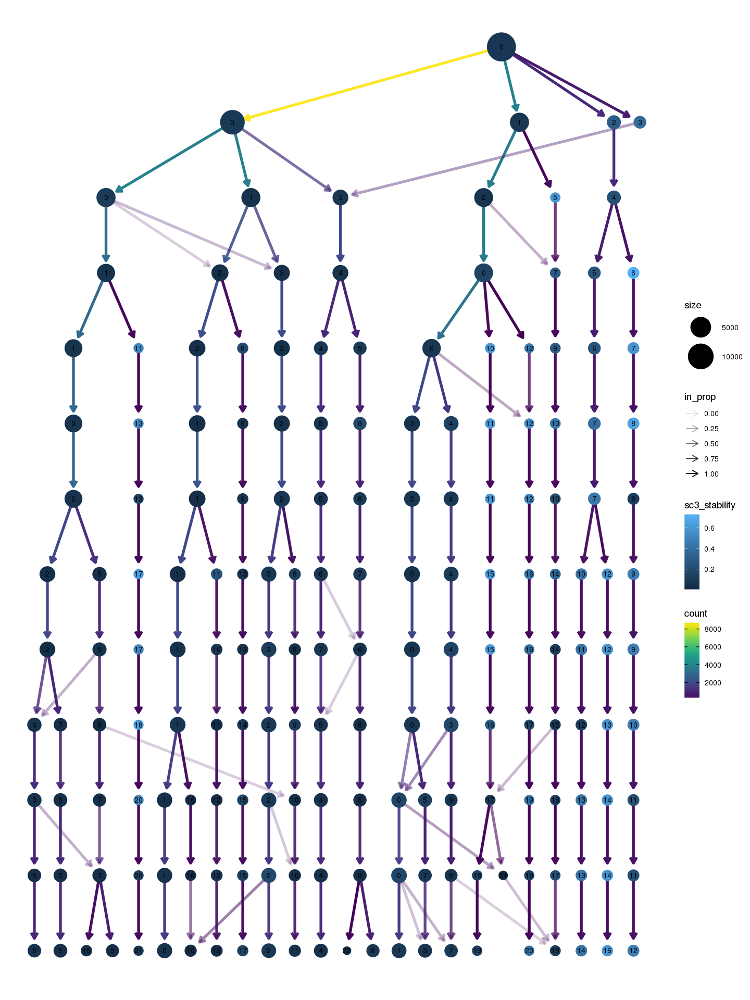

In [20]:
options(repr.plot.width=12, repr.plot.height=16)
clustree(CL10, node_colour = "sc3_stability") 

In [21]:
# 用來算clustree每一層也就是分幾群的時候分數最高 
# :: 是用來找一個package下的某個function, :::是用來找一個package下的某個隱藏function
tmp <- clustree:::calc_sc3_stability(CL10[[]][,6:19])
# 標準差 / 平均值 / 變異係數
data.frame(tmp) %>% group_by(resolution) %>% summarise(sum(stability),sd(stability),mean(stability),sd(stability)/mean(stability)) 

resolution,sum(stability),sd(stability),mean(stability),sd(stability)/mean(stability)
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0.07894426,NA,0.07894426,NA
2,0.84167889,0.1576089,0.21041972,0.7490215
3,1.10998307,0.2134856,0.18499718,1.1539938
4,1.60841515,0.2402248,0.20105189,1.1948400
5,3.32886516,0.2264224,0.25606655,0.8842326
6,3.88679233,0.2512139,0.27762802,0.9048577
7,2.61430631,0.1939366,0.18673616,1.0385596
8,4.66728992,0.2338559,0.25929388,0.9018953
9,4.06155387,0.2261433,0.22564188,1.0022223


In [22]:
head(CL10[[]][,6:19])

,RNA_snn_res.0,RNA_snn_res.0.1,RNA_snn_res.0.2,RNA_snn_res.0.3,RNA_snn_res.0.4,RNA_snn_res.0.5,RNA_snn_res.0.6,RNA_snn_res.0.7,RNA_snn_res.0.8,RNA_snn_res.0.9,RNA_snn_res.1,RNA_snn_res.1.1,RNA_snn_res.1.2,seurat_clusters
,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
AAACCTGAGGATATAC-CL1-0-P-4,0,0,0,1,1,0,0,2,2,4,3,6,6,6
AAACCTGCACAGTCGC-CL1-0-P-4,0,0,1,2,2,1,1,1,1,1,1,1,0,0
AAACCTGCACATTTCT-CL1-0-P-4,0,0,0,1,1,0,0,2,2,4,3,6,6,6
AAACCTGGTTAAAGAC-CL1-0-P-4,0,0,0,1,1,0,0,5,5,6,7,3,15,15
AAACGGGGTCCCTACT-CL1-0-P-4,0,0,0,1,1,0,0,5,5,4,3,3,9,9
AAACGGGTCACCATAG-CL1-0-P-4,0,0,0,1,1,0,0,5,5,6,7,3,15,15


In [23]:
clust.data = clustree(CL10, node_colour = "sc3_stability", node_label = "sc3_stability",  node_text_colour = "white", node_size_range = c(6, 17))

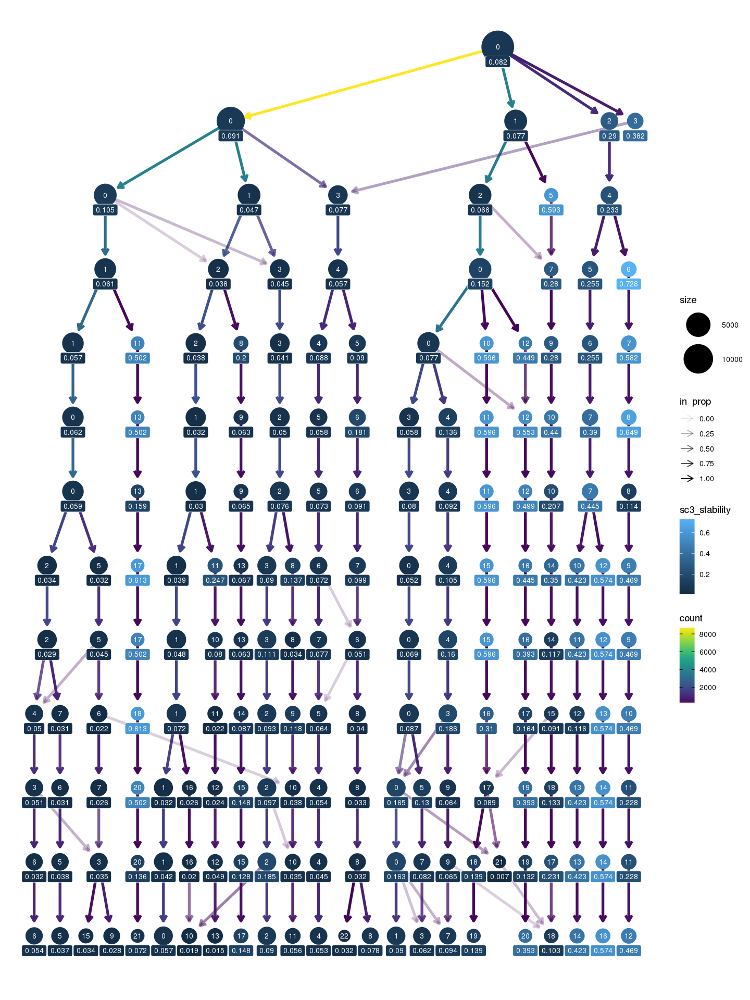

In [24]:
new.sc3_stability = ceil(clust.data$data$sc3_stability*1000)/1000
clust.data$data$sc3_stability = new.sc3_stability
options(repr.plot.width=12, repr.plot.height=16)
clust.data

<h4><u>TSNE / UMAP</u></h4>

In [201]:
CL10 <- FindNeighbors(object = CL10, reduction = "pca", dims = 1:pc)
CL10 <- FindClusters(CL10, resolution = 0.3)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9041
Number of communities: 8
Elapsed time: 2 seconds


In [26]:
CL10 <- RunUMAP(CL10, reduction = "pca", dims = 1:pc)
CL10 <- RunTSNE(CL10, reduction = "pca", dims = 1:pc, max_iter = 2000)

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
04:17:05 UMAP embedding parameters a = 0.9922 b = 1.112

04:17:06 Read 14169 rows and found 61 numeric columns

04:17:06 Using Annoy for neighbor search, n_neighbors = 30

04:17:06 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

|

04:17:09 Writing NN index file to temp file /tmp/RtmpLKj6St/file1495d12ad5e

04:17:09 Searching Annoy index using 64 threads, search_k = 3000

04:17:10 Annoy recall = 100%

04:17:11 Commencing smooth kNN distance calibration using 64 threads

04:17:13 Initializin

In [27]:
str(CL10)

Formal class 'Seurat' [package "Seurat"] with 12 slots
  ..@ assays      :List of 2
  .. ..$ RNA   :Formal class 'Assay' [package "Seurat"] with 8 slots
  .. .. .. ..@ counts       :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int [1:75800282] 14 21 22 26 27 39 41 43 45 47 ...
  .. .. .. .. .. ..@ p       : int [1:14170] 0 5160 10430 16096 21800 28212 34654 41003 47064 52109 ...
  .. .. .. .. .. ..@ Dim     : int [1:2] 33538 14169
  .. .. .. .. .. ..@ Dimnames:List of 2
  .. .. .. .. .. .. ..$ : chr [1:33538] "MIR1302-2HG" "FAM138A" "OR4F5" "AL627309.1" ...
  .. .. .. .. .. .. ..$ : chr [1:14169] "AAACCTGAGGATATAC-CL1-0-P-4" "AAACCTGCACAGTCGC-CL1-0-P-4" "AAACCTGCACATTTCT-CL1-0-P-4" "AAACCTGGTTAAAGAC-CL1-0-P-4" ...
  .. .. .. .. .. ..@ x       : num [1:75800282] 1 2 1 43 13 8 1 5 2 1 ...
  .. .. .. .. .. ..@ factors : list()
  .. .. .. ..@ data         :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int 

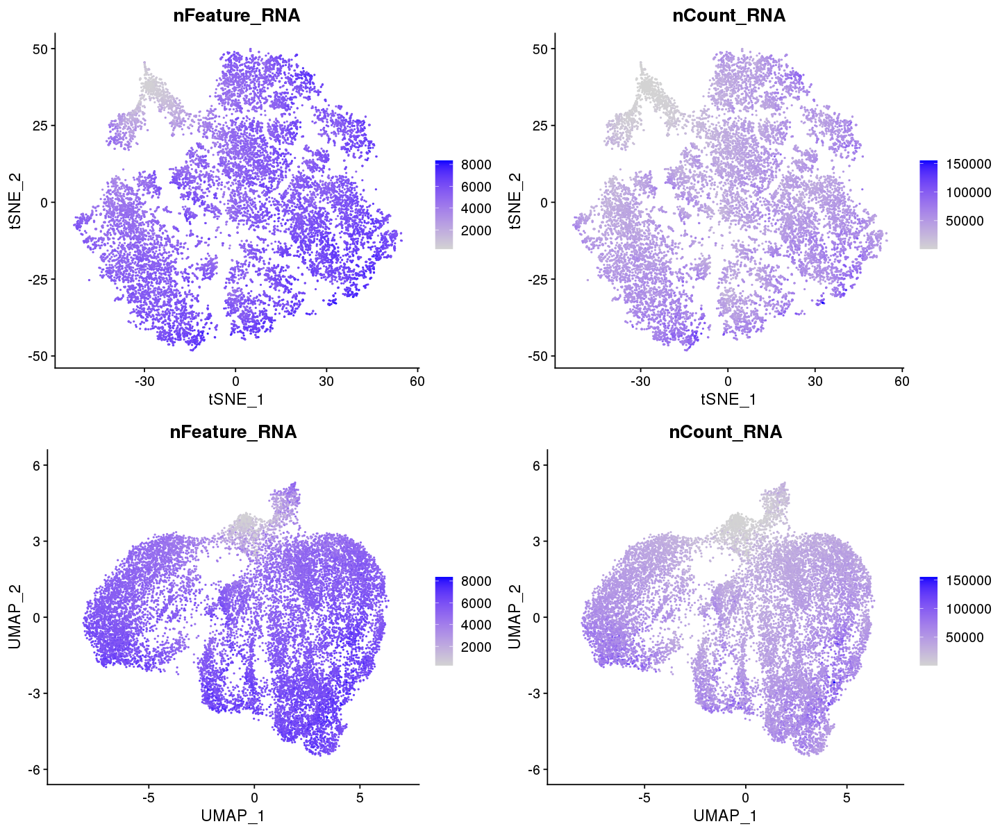

In [28]:
options(repr.plot.width=12, repr.plot.height=10)
fp1 <- FeaturePlot(CL10, features = "nFeature_RNA", pt.size = 0.25, reduction = "tsne")
fp2 <- FeaturePlot(CL10, features = "nCount_RNA", pt.size = 0.25, reduction = "tsne")
fp3 <- FeaturePlot(CL10, features = "nFeature_RNA", pt.size = 0.25, reduction = "umap")
fp4 <- FeaturePlot(CL10, features = "nCount_RNA", pt.size = 0.25, reduction = "umap")
plot_grid(fp1, fp2, fp3, fp4, ncol = 2, nrow = 2)

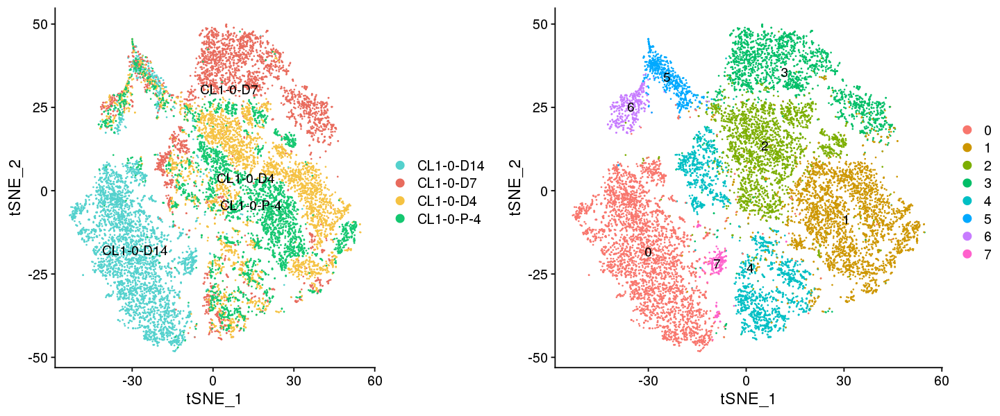

In [30]:
options(repr.plot.width=12, repr.plot.height=5)
tp1 <- DimPlot(object = CL10, reduction = "tsne", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
tp2 <- DimPlot(object = CL10, reduction = "tsne", label = TRUE) 
plot_grid(tp1, tp2)

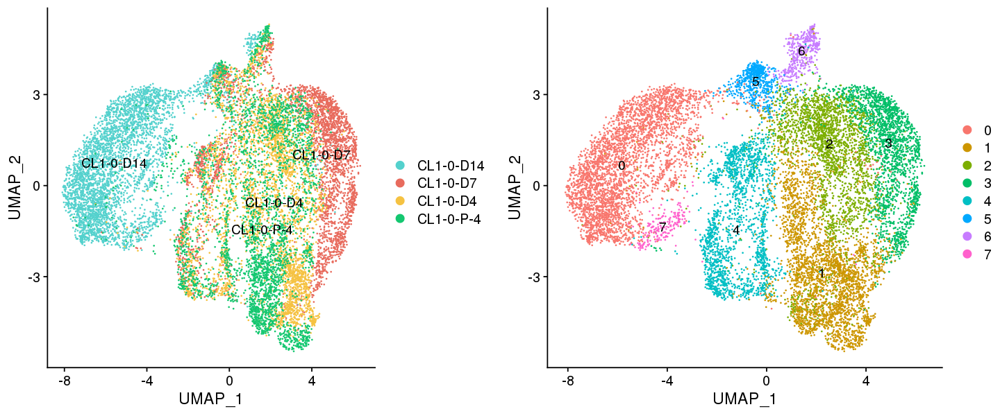

In [31]:
options(repr.plot.width=12, repr.plot.height=5)
up1 <- DimPlot(object = CL10, reduction = "umap", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
up2 <- DimPlot(object = CL10, reduction = "umap", label = TRUE) 
plot_grid(up1, up2)

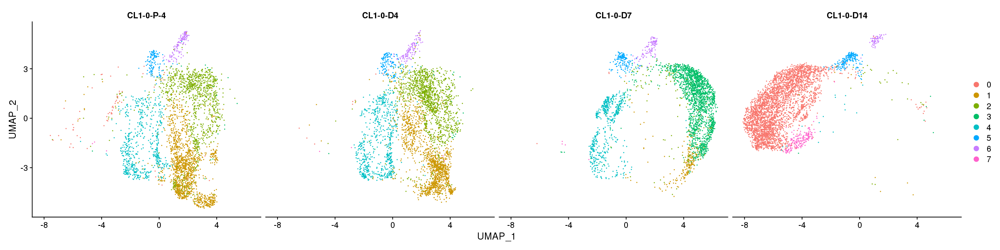

In [205]:
CL10@meta.data$condition<-factor(CL10@meta.data$condition, levels = order_list)
options(repr.plot.width=20, repr.plot.height=5)
DimPlot(object = CL10, reduction = "umap", split.by = "condition", ncol = 4)

<h4><u>Cluster Composition</u></h4>

In [33]:
plot.data <- CL10@meta.data %>%
    select(condition, cluster = RNA_snn_res.0.3) %>%
    mutate(cluster = factor(cluster)) %>%
    mutate(condition = factor(condition, levels = order_list))%>%
    group_by(cluster, condition) %>%
    summarise(count = n()) %>%
    mutate(clust_total = sum(count)) %>%
    mutate(clust_prop = count / clust_total) %>%
    group_by(condition) %>%
    mutate(dataset_total = sum(count)) %>%
    ungroup() %>%
    mutate(dataset_prop = count / dataset_total)

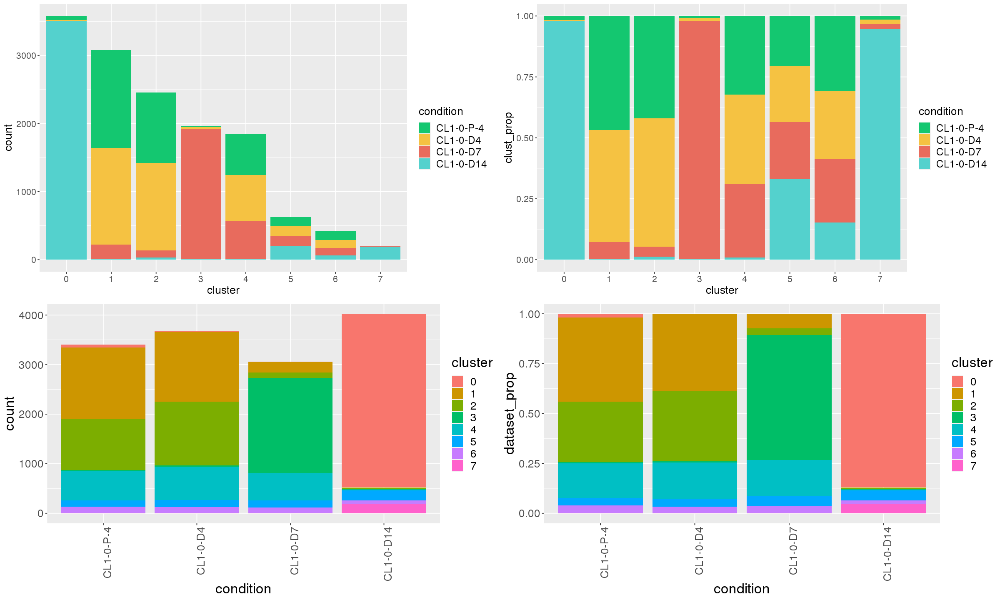

In [34]:
options(repr.plot.width=20, repr.plot.height=12)

gp1<-ggplot(plot.data, aes(x = cluster, y = count, fill = condition)) +
    geom_col()+
    scale_fill_manual(values = color_style)+
    theme(legend.text=element_text(size=15), text = element_text(size = 16))

gp2<-ggplot(plot.data, aes(x = cluster, y = clust_prop, fill = condition)) +
    geom_col()+
    scale_fill_manual(values = color_style)+
    theme(legend.text=element_text(size=15), text = element_text(size = 16))

gp3<-ggplot(plot.data, aes(x = condition, y = count, fill = cluster)) +
    geom_col()+
    theme(text = element_text(size = 20), axis.text.x = element_text(angle=90, hjust=1))

gp4<-ggplot(plot.data, aes(x = condition, y = dataset_prop, fill = cluster)) +
    geom_col()+
    theme(text = element_text(size = 20), axis.text.x = element_text(angle=90, hjust=1))

plot_grid(gp1, gp2, gp3, gp4, ncol = 2)

In [35]:
saveRDS(file ="/mnt/isilonX200/scRNA/Project_1/Result/CL1_0.rds", object = CL10)

<h2>5.Cell Cycle</h2>

In [36]:
CL10 <- CellCycleScoring(
  object = CL10,
  g2m.features = cc.genes$g2m.genes,
  s.features = cc.genes$s.genes,
  assay="logCPM"
)
#CL10 <- CellCycleScoring(object = CL10, g2m.features = intersect(rownames(CL10), cc.genes$g2m.genes), s.features = intersect(rownames(CL10), cc.genes$s.genes), assay='logCPM')

Warning message:
"The following features are not present in the object: MLF1IP, not searching for symbol synonyms"
Warning message:
"The following features are not present in the object: FAM64A, HN1, not searching for symbol synonyms"


In [37]:
head(CL10@meta.data,3)

,orig.ident,nCount_RNA,nFeature_RNA,condition,percent.MT,RNA_snn_res.0,RNA_snn_res.0.1,RNA_snn_res.0.2,RNA_snn_res.0.3,RNA_snn_res.0.4,...,RNA_snn_res.0.7,RNA_snn_res.0.8,RNA_snn_res.0.9,RNA_snn_res.1,RNA_snn_res.1.1,RNA_snn_res.1.2,seurat_clusters,S.Score,G2M.Score,Phase
,<chr>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,...,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<fct>
AAACCTGAGGATATAC-CL1-0-P-4,Project_1,34903,5160,CL1-0-P-4,6.890525,0,0,0,1,1,...,2,2,4,3,6,6,1,-0.10743669,0.10028783,G2M
AAACCTGCACAGTCGC-CL1-0-P-4,Project_1,44235,5270,CL1-0-P-4,3.759466,0,0,1,2,2,...,1,1,1,1,1,0,2,-0.20233657,-0.29398483,G1
AAACCTGCACATTTCT-CL1-0-P-4,Project_1,50947,5666,CL1-0-P-4,3.232771,0,0,0,1,1,...,2,2,4,3,6,6,1,-0.05336634,0.01003614,G2M


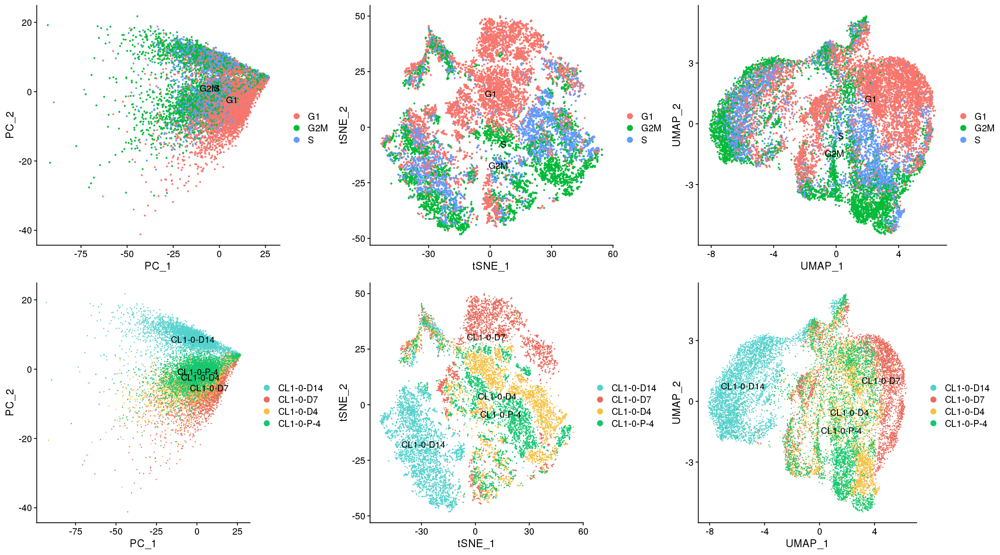

In [38]:
#1.G1(細胞生長) #2.S(DNA複製) #3.G2(增長)->M(分裂)
options(repr.plot.width = 18, repr.plot.height = 10)
ccp1 <- DimPlot(CL10, reduction = "pca", label = TRUE, group.by = "Phase", pt.size = 0.5)
ccp2 <- DimPlot(CL10, reduction = "tsne", label = TRUE, group.by = "Phase", pt.size = 0.5)
ccp3 <- DimPlot(CL10, reduction = "umap", label = TRUE, group.by = "Phase", pt.size = 0.5)
dimp1 <- DimPlot(object = CL10, reduction = "pca", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
tp1 <- DimPlot(object = CL10, reduction = "tsne", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
up1 <- DimPlot(object = CL10, reduction = "umap", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
plot_grid(ccp1, ccp2, ccp3, dimp1, tp1, up1, ncol = 3, nrow =2)

In [153]:
# saveRDS(file ="/mnt/isilonX200/scRNA/Project_1/Result/CL1_0_CellCycle.rds", object = CL10)
CL10 <- readRDS(file ="/mnt/isilonX200/scRNA/Project_1/Result/CL1_0_CellCycle.rds")

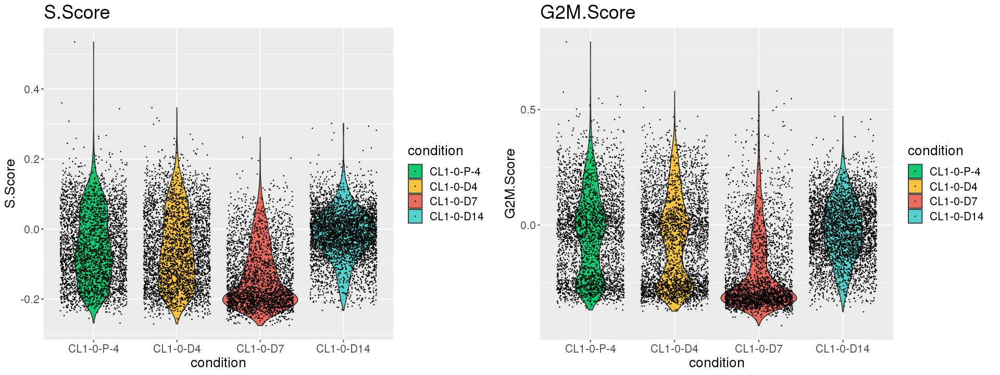

In [40]:
options(repr.plot.width=16, repr.plot.height=6)
ccvgp1 <- ggplot(CL10[[]], aes(x=condition, y=S.Score, fill=condition))+
        geom_violin()+
        geom_point(position="jitter", size=0.1)+
        theme(text = element_text(size = 16), plot.title = element_text(size=22))+
        scale_x_discrete(limits = order_list)+
        scale_fill_manual(values = color_style, breaks = order_list)+
        labs(title = "S.Score")
ccvgp2 <- ggplot(CL10[[]], aes(x=condition, y=G2M.Score, fill=condition))+
        geom_violin()+
        geom_point(position="jitter", size=0.1)+
        theme(text = element_text(size = 16), plot.title = element_text(size=22))+
        scale_x_discrete(limits = order_list)+
        scale_fill_manual(values = color_style, breaks = order_list)+
        labs(title = "G2M.Score")
plot_grid(ccvgp1, ccvgp2, ncol = 2)

<h2>6.Different Expression</h2>

In [232]:
head(CL10@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,condition,percent.MT,RNA_snn_res.0,RNA_snn_res.0.1,RNA_snn_res.0.2,RNA_snn_res.0.3,RNA_snn_res.0.4,...,RNA_snn_res.0.7,RNA_snn_res.0.8,RNA_snn_res.0.9,RNA_snn_res.1,RNA_snn_res.1.1,RNA_snn_res.1.2,seurat_clusters,S.Score,G2M.Score,Phase
,<chr>,<dbl>,<int>,<fct>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,...,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<fct>
AAACCTGAGGATATAC-CL1-0-P-4,Project_1,34903,5160,CL1-0-P-4,6.890525,0,0,0,1,1,...,2,2,4,3,6,6,1,-0.107436694,0.10028783,G2M
AAACCTGCACAGTCGC-CL1-0-P-4,Project_1,44235,5270,CL1-0-P-4,3.759466,0,0,1,2,2,...,1,1,1,1,1,0,2,-0.202336574,-0.29398483,G1
AAACCTGCACATTTCT-CL1-0-P-4,Project_1,50947,5666,CL1-0-P-4,3.232771,0,0,0,1,1,...,2,2,4,3,6,6,1,-0.053366337,0.01003614,G2M
AAACCTGGTTAAAGAC-CL1-0-P-4,Project_1,48822,5704,CL1-0-P-4,4.362787,0,0,0,1,1,...,5,5,6,7,3,15,1,-0.019682153,0.03967300,G2M
AAACGGGGTCCCTACT-CL1-0-P-4,Project_1,57224,6412,CL1-0-P-4,2.855445,0,0,0,1,1,...,5,5,4,3,3,9,1,-0.049966540,0.20111678,G2M
AAACGGGTCACCATAG-CL1-0-P-4,Project_1,60751,6442,CL1-0-P-4,3.932446,0,0,0,1,1,...,5,5,6,7,3,15,1,0.007169003,-0.02092221,S


In [168]:
CL10.markers <- FindAllMarkers(object = CL10, features = VariableFeatures(CL10)) 
top20 = CL10.markers %>% group_by(cluster) %>% top_n(n = 20, wt = avg_logFC)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7



In [42]:
head(top20)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,Inf,0.996,0.910,0,0,MT2A
0,Inf,1.000,0.989,0,0,ACTG1
0,Inf,1.000,0.992,0,0,LGALS1
0,Inf,1.000,0.997,0,0,RPL38
0,Inf,1.000,0.996,0,0,RPS29
0,Inf,1.000,0.997,0,0,RPL37A


In [43]:
MinMax <- function(data, min, max) {
  data2 <- data
  data2[data2 > max] <- max
  data2[data2 < min] <- min
  return(data2)
}

plot_heatmap <- as.data.frame(x = t(as.matrix(x = t(x = GetAssayData(
    object = CL10,
    slot = 'scale.data')[top20$gene ,cells <- colnames(x = CL10)]))))

annotation_col <- CL10@meta.data[,c("condition","RNA_snn_res.0.3"), drop = FALSE]
annotation_col <- annotation_col[order(annotation_col$RNA_snn_res.0.3, annotation_col$condition),]
plot_heatmap <- plot_heatmap[,rownames(annotation_col)]
plot_heatmap <- MinMax(plot_heatmap,-3.5,3.5)
aka3 = list(condition = color_style)

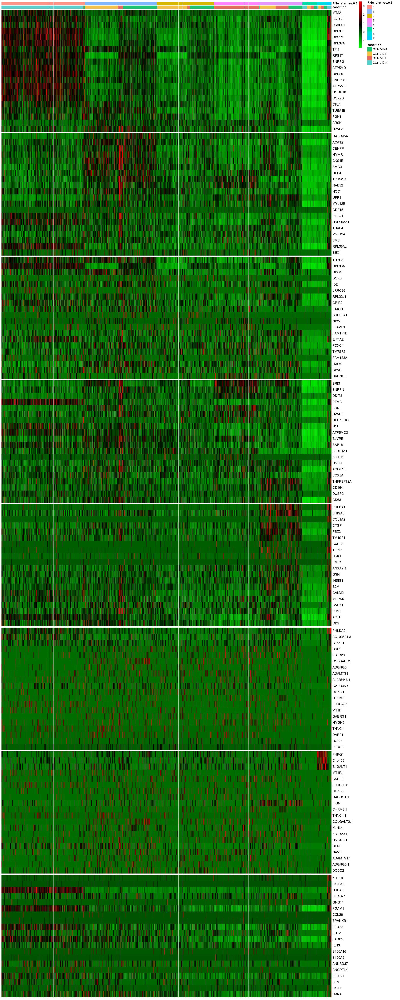

In [44]:
options(repr.plot.width = 18, repr.plot.height = 45)
pheatmap(plot_heatmap,
         annotation_col = annotation_col,
         annotation_colors = aka3[1],
         cluster_rows = FALSE, 
         cluster_cols = FALSE,
         show_colnames = FALSE,
         gaps_row = cumsum(table(top20$cluster)),
         gaps_col = cumsum(table(annotation_col$seurat_clusters)),
         color = greenred(100),
         fontsize_row=11
         )

<h4>CL1-0 - cellcycle - group by condition<h4>

In [45]:
MinMax <- function(data, min, max) {
  data2 <- data
  data2[data2 > max] <- max
  data2[data2 < min] <- min
  return(data2)
}

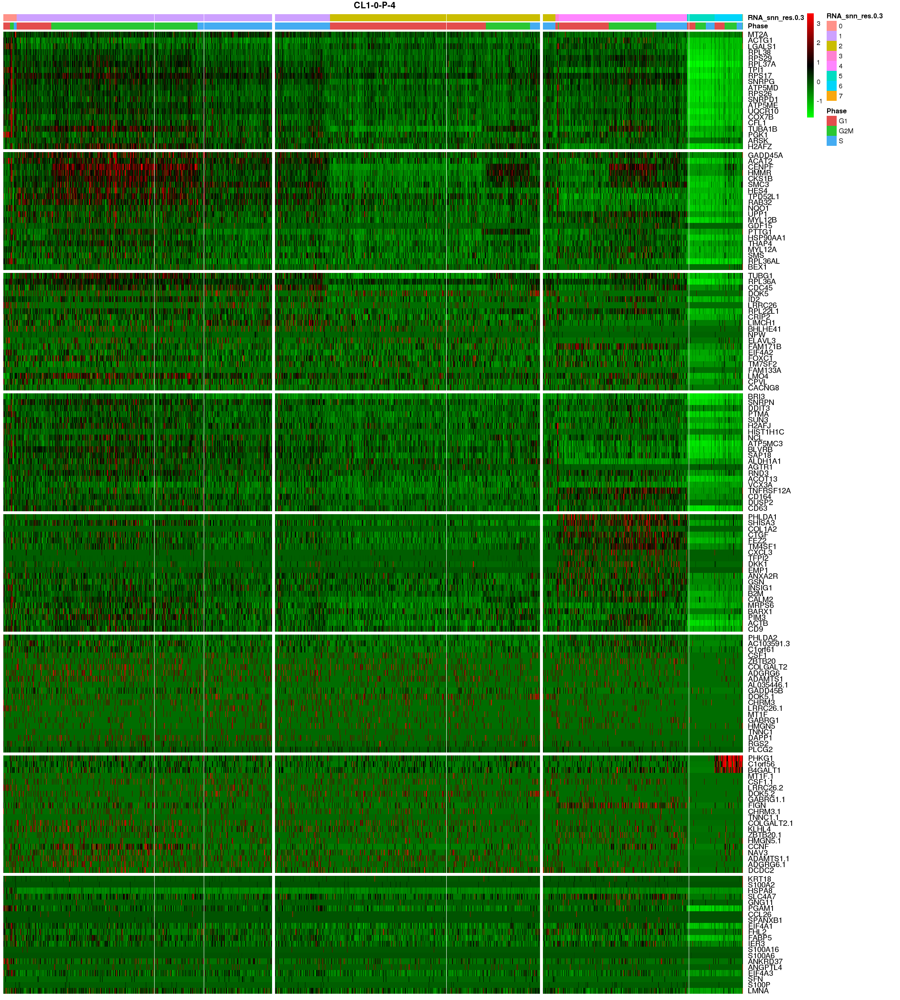

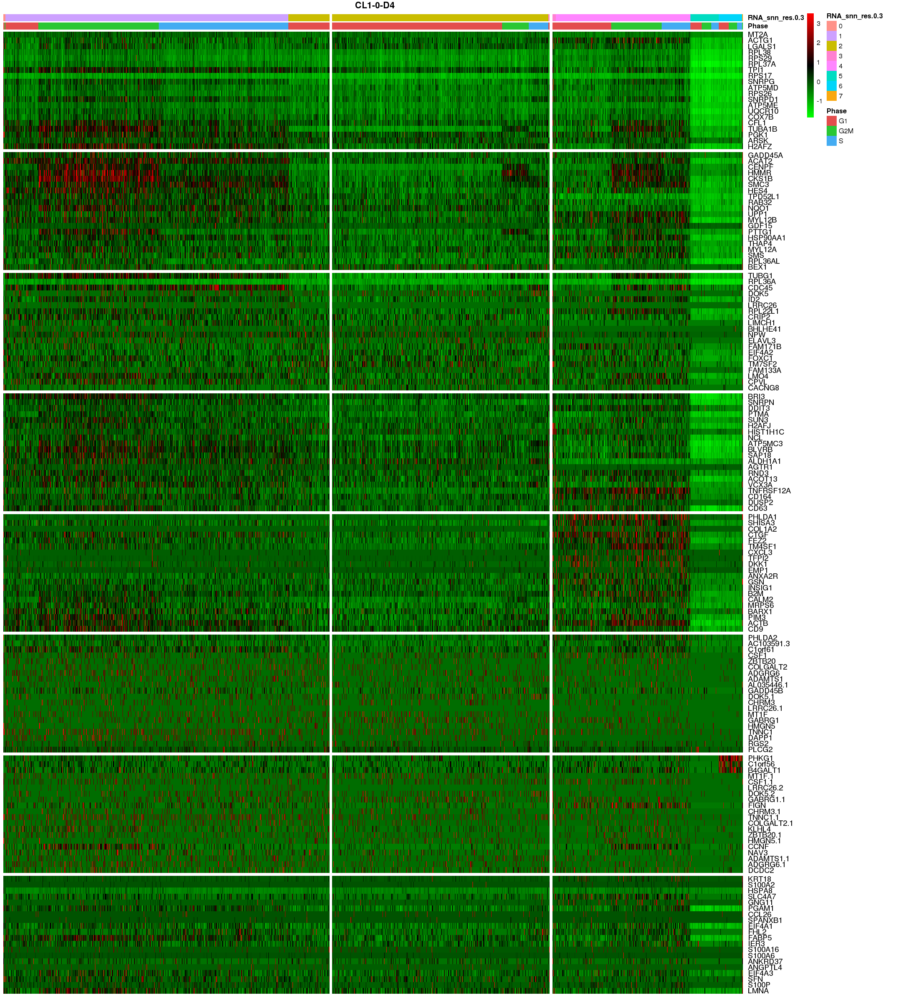

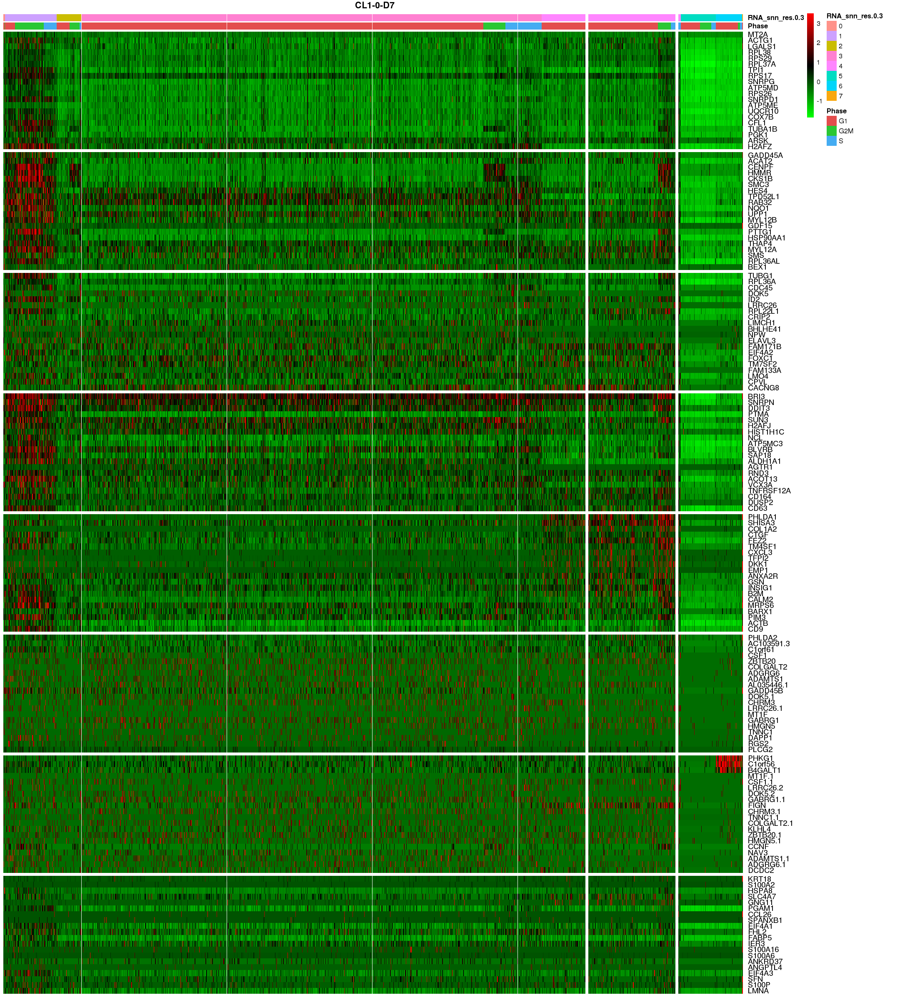

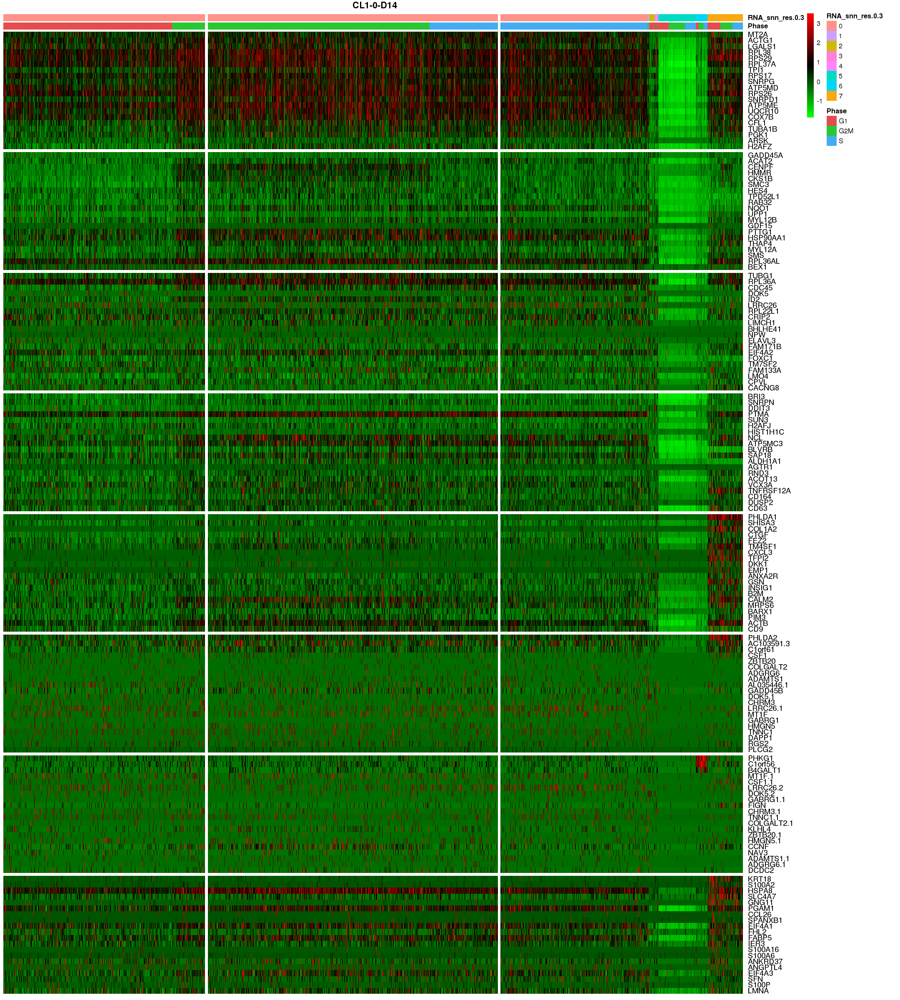

In [46]:
for (i in order_list){
    ccgroup <- subset(CL10@meta.data, condition == i)
    cc_plot_heatmap <- as.data.frame(x = t(as.matrix(x = t(x = GetAssayData(
        object = CL10,
        slot = 'scale.data')[top20$gene , cells <- rownames(ccgroup)]))))

    annotation_col <- ccgroup[,c("Phase","RNA_snn_res.0.3"), drop = FALSE]
    annotation_col <- annotation_col[order(annotation_col$RNA_snn_res.0.3, annotation_col$Phase),]
    cc_plot_heatmap <- cc_plot_heatmap[,rownames(annotation_col)]
    cc_plot_heatmap <- MinMax(cc_plot_heatmap, -3.5,3.5)
    aka3 = list(Phase = c("G1" = "#e34d4d", "G2M" = "#2ac734", "S" = "#44acf2"))

    options(repr.plot.width = 18, repr.plot.height = 20)
    pheatmap(cc_plot_heatmap,
         main = i,
         annotation_col = annotation_col,
         annotation_colors = aka3[1],
         cluster_rows = FALSE, 
         cluster_cols = FALSE,
         show_colnames = FALSE,
         gaps_row = cumsum(table(top20$cluster)),
         gaps_col = cumsum(table(annotation_col$Phase)),
         color = greenred(100),
         fontsize_row=11
         )
}

In [47]:
#saveRDS(file ="/mnt/isilonX200/scRNA/Project_1/Result/CL1_0_markers.rds", object = CL10.markers)

<h1>Res 1.2<h2>

In [48]:
CL10 <- FindNeighbors(object = CL10, reduction = "pca", dims = 1:pc)
CL10 <- FindClusters(CL10, resolution = 1.2)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8132
Number of communities: 23
Elapsed time: 2 seconds


In [49]:
CL10 <- RunUMAP(CL10, reduction = "pca", dims = 1:pc)
CL10 <- RunTSNE(CL10, reduction = "pca", dims = 1:pc, max_iter = 2000)

04:29:09 UMAP embedding parameters a = 0.9922 b = 1.112

04:29:09 Read 14169 rows and found 61 numeric columns

04:29:09 Using Annoy for neighbor search, n_neighbors = 30

04:29:09 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

|

04:29:15 Writing NN index file to temp file /tmp/RtmpLKj6St/file14949350945

04:29:15 Searching Annoy index using 64 threads, search_k = 3000

04:29:15 Annoy recall = 100%

04:29:16 Commencing smooth kNN distance calibration using 64 threads

04:29:18 Initializing from normalized Laplacian + noise

04:29:18 Commencing optimization for 200 epochs, with 652044 positive edges

04:29:35 Optimization finished



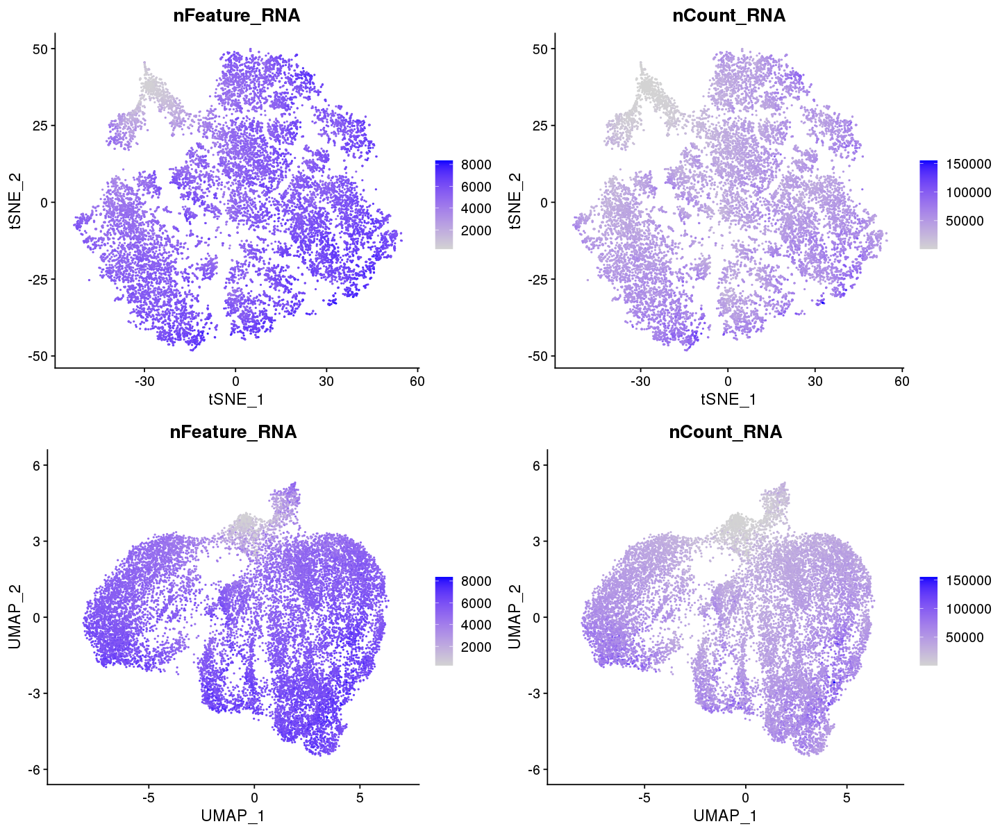

In [50]:
options(repr.plot.width=12, repr.plot.height=10)
fp1 <- FeaturePlot(CL10, features = "nFeature_RNA", pt.size = 0.25, reduction = "tsne")
fp2 <- FeaturePlot(CL10, features = "nCount_RNA", pt.size = 0.25, reduction = "tsne")
fp3 <- FeaturePlot(CL10, features = "nFeature_RNA", pt.size = 0.25, reduction = "umap")
fp4 <- FeaturePlot(CL10, features = "nCount_RNA", pt.size = 0.25, reduction = "umap")
plot_grid(fp1, fp2, fp3, fp4, ncol = 2, nrow = 2)

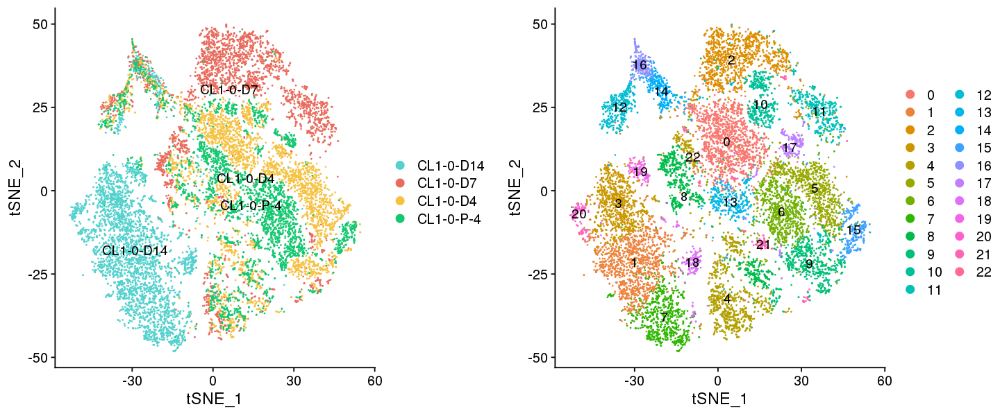

In [51]:
options(repr.plot.width=12, repr.plot.height=5)
tp1 <- DimPlot(object = CL10, reduction = "tsne", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
tp2 <- DimPlot(object = CL10, reduction = "tsne", label = TRUE) 
plot_grid(tp1, tp2)

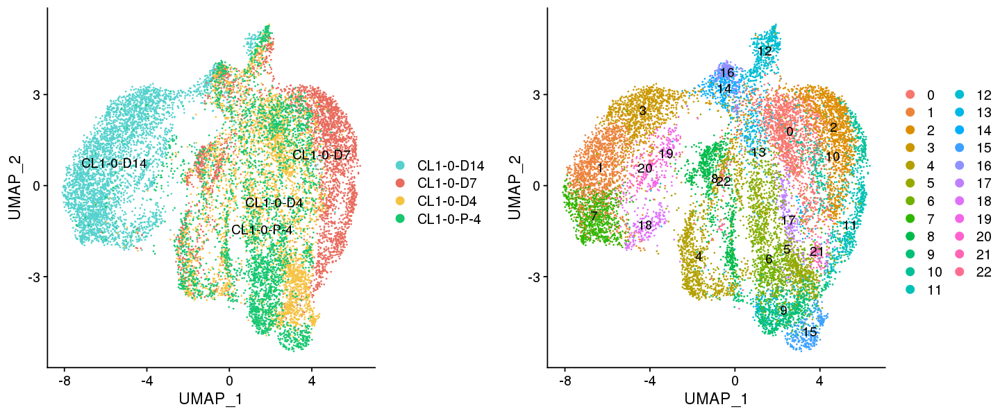

In [52]:
options(repr.plot.width=12, repr.plot.height=5)
up1 <- DimPlot(object = CL10, reduction = "umap", group.by = "condition", order = order_list, label = TRUE, cols = color_style)
up2 <- DimPlot(object = CL10, reduction = "umap", label = TRUE) 
plot_grid(up1, up2)

<h2>7.Pesudotime Analysis</h2>

In [53]:
library(monocle)

Loading required package: VGAM

Loading required package: splines


Attaching package: 'VGAM'


The following objects are masked from 'package:pracma':

    Rank, erf, erfc, expint, logit, loglog, zeta


Loading required package: DDRTree

Loading required package: irlba



In [54]:
data <- as(as.matrix(CL10@assays$RNA@counts), 'sparseMatrix')

In [55]:
pd <- new('AnnotatedDataFrame', data = CL10@meta.data)

In [56]:
fData <- data.frame(gene_short_name = row.names(data), row.names = row.names(data))
fd <- new('AnnotatedDataFrame', data = fData)

In [57]:
#Construct monocle cds
monocle_cds <- newCellDataSet(data,
                              phenoData = pd,
                              featureData = fd,
                              lowerDetectionLimit = 0.5,
                              expressionFamily = negbinomial.size())

In [58]:
CL10.M <- monocle_cds
CL10.M <- estimateSizeFactors(CL10.M)
CL10.M <- estimateDispersions(CL10.M)

Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message:
"glm.fit: algorithm did not converge"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step size truncated due to divergence"
Warning message in log(ifelse(y == 0, 1, y/mu)):
"NaNs produced"
Warning message:
"step siz

In [59]:
str(CL10.M)

Formal class 'CellDataSet' [package "monocle"] with 19 slots
  ..@ reducedDimS          : num[0 , 0 ] 
  ..@ reducedDimW          : num[0 , 0 ] 
  ..@ reducedDimA          : num[0 , 0 ] 
  ..@ reducedDimK          : num[0 , 0 ] 
  ..@ minSpanningTree      :Formal class 'igraph' [package "monocle"] with 1 slot
  .. .. ..@ .S3Class: chr "igraph"
  ..@ cellPairwiseDistances: num[0 , 0 ] 
  ..@ expressionFamily     :Formal class 'vglmff' [package "VGAM"] with 22 slots
  .. .. ..@ blurb             : chr [1:6] "Negative-binomial distribution with size known\n\n" "Links:    " "loglink(mu)" "\n" ...
  .. .. ..@ constraints       :  expression({  constraints <- cm.zero.VGAM(constraints, x = x, NULL, M = M, predictors.names = predictors.names,  M1 = 2) })
  .. .. ..@ deviance          :function ()  
  .. .. ..@ fini              :  expression({ })
  .. .. ..@ first             :  expression({ })
  .. .. ..@ infos             :function (...)  
  .. .. ..@ initialize        :  expression({  M1 <-

In [60]:
CL10.M <- detectGenes(CL10.M, min_expr = 3 )

In [61]:
head(fData(CL10.M)[order(-fData(CL10.M)$num_cells_expressed),])

,gene_short_name,num_cells_expressed
,<fct>,<int>
RPS18,RPS18,14150
RPL13,RPL13,14126
RPS19,RPS19,14124
FTH1,FTH1,14114
RPL41,RPL41,14103
RPS27A,RPS27A,14100


In [62]:
expressed_genes <- rownames(subset(fData(CL10.M), num_cells_expressed >= 10))
head(expressed_genes)

[1] "AL669831.5" "SAMD11"     "NOC2L"      "KLHL17"     "HES4"      
[6] "ISG15"

In [63]:
print(head(pData(CL10.M)[,c(0:5)]))

                           orig.ident nCount_RNA nFeature_RNA condition
AAACCTGAGGATATAC-CL1-0-P-4  Project_1      34903         5160 CL1-0-P-4
AAACCTGCACAGTCGC-CL1-0-P-4  Project_1      44235         5270 CL1-0-P-4
AAACCTGCACATTTCT-CL1-0-P-4  Project_1      50947         5666 CL1-0-P-4
AAACCTGGTTAAAGAC-CL1-0-P-4  Project_1      48822         5704 CL1-0-P-4
AAACGGGGTCCCTACT-CL1-0-P-4  Project_1      57224         6412 CL1-0-P-4
AAACGGGTCACCATAG-CL1-0-P-4  Project_1      60751         6442 CL1-0-P-4
                           percent.MT
AAACCTGAGGATATAC-CL1-0-P-4   6.890525
AAACCTGCACAGTCGC-CL1-0-P-4   3.759466
AAACCTGCACATTTCT-CL1-0-P-4   3.232771
AAACCTGGTTAAAGAC-CL1-0-P-4   4.362787
AAACGGGGTCCCTACT-CL1-0-P-4   2.855445
AAACGGGTCACCATAG-CL1-0-P-4   3.932446


In [64]:
# normalize visualization
L <- log(exprs(CL10.M[expressed_genes,]))

In [65]:
library(reshape)
melted_dens_df <- melt(Matrix::t(scale(Matrix::t(L))))


Attaching package: 'reshape'


The following object is masked from 'package:dplyr':

    rename


The following object is masked from 'package:cowplot':

    stamp


The following object is masked from 'package:Matrix':

    expand


The following objects are masked from 'package:S4Vectors':

    expand, rename




In [119]:
head(subset(melted_dens_df, value>0))

,X1,X2,value
,<fct>,<fct>,<dbl>
11053,RPS18,AAACCTGCACAGTCGC-CL1-0-P-4,0.304403583
19420,RPS18,AAACCTGCACATTTCT-CL1-0-P-4,0.556672890
27787,RPS18,AAACCTGGTTAAAGAC-CL1-0-P-4,0.003403495
36154,RPS18,AAACGGGGTCCCTACT-CL1-0-P-4,0.015057166
44521,RPS18,AAACGGGTCACCATAG-CL1-0-P-4,0.139869938
52888,RPS18,AAACGGGTCAGCACAT-CL1-0-P-4,0.172570116


Warning message:
"Removed 118537854 rows containing non-finite values (stat_density)."


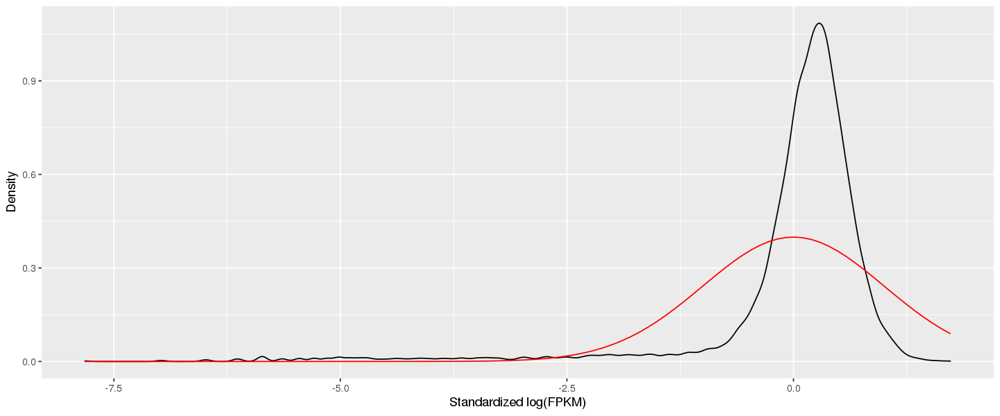

In [66]:
qplot(value, geom = "density", data = melted_dens_df) +
    stat_function(fun = dnorm, size = 0.5, color = 'red') +
    xlab("Standardized log(FPKM)") +
    ylab("Density")

<h4><u>Step1.選擇定義發展基因</u></h4>

In [67]:
options(mc.cores = 64)
library(future)
plan("multiprocess", workers = 12)
diff_test_res <- differentialGeneTest(CL10.M, fullModelFormulaStr = "~RNA_snn_res.0.3") 

In [225]:
head(diff_test_res)

,status,family,pval,qval,gene_short_name,num_cells_expressed
,<fct>,<fct>,<dbl>,<dbl>,<fct>,<int>
MIR1302-2HG,OK,negbinomial.size,1.0000000,1.0000000,MIR1302-2HG,0
FAM138A,OK,negbinomial.size,1.0000000,1.0000000,FAM138A,0
OR4F5,OK,negbinomial.size,1.0000000,1.0000000,OR4F5,0
AL627309.1,OK,negbinomial.size,0.1960190,0.4162658,AL627309.1,0
AL627309.3,OK,negbinomial.size,0.8915006,1.0000000,AL627309.3,0
AL627309.2,OK,negbinomial.size,1.0000000,1.0000000,AL627309.2,0


In [69]:
ordering_genes <- row.names (subset(diff_test_res, qval < 0.01))

<h4><u>Step2.數據集降維</u></h4>

In [70]:
CL10.M <- setOrderingFilter(CL10.M, ordering_genes)

In [71]:
str(CL10.M)

Formal class 'CellDataSet' [package "monocle"] with 19 slots
  ..@ reducedDimS          : num[0 , 0 ] 
  ..@ reducedDimW          : num[0 , 0 ] 
  ..@ reducedDimA          : num[0 , 0 ] 
  ..@ reducedDimK          : num[0 , 0 ] 
  ..@ minSpanningTree      :Formal class 'igraph' [package "monocle"] with 1 slot
  .. .. ..@ .S3Class: chr "igraph"
  ..@ cellPairwiseDistances: num[0 , 0 ] 
  ..@ expressionFamily     :Formal class 'vglmff' [package "VGAM"] with 22 slots
  .. .. ..@ blurb             : chr [1:6] "Negative-binomial distribution with size known\n\n" "Links:    " "loglink(mu)" "\n" ...
  .. .. ..@ constraints       :  expression({  constraints <- cm.zero.VGAM(constraints, x = x, NULL, M = M, predictors.names = predictors.names,  M1 = 2) })
  .. .. ..@ deviance          :function ()  
  .. .. ..@ fini              :  expression({ })
  .. .. ..@ first             :  expression({ })
  .. .. ..@ infos             :function (...)  
  .. .. ..@ initialize        :  expression({  M1 <-

Warning message:
"Transformation introduced infinite values in continuous y-axis"
Warning message:
"Transformation introduced infinite values in continuous y-axis"


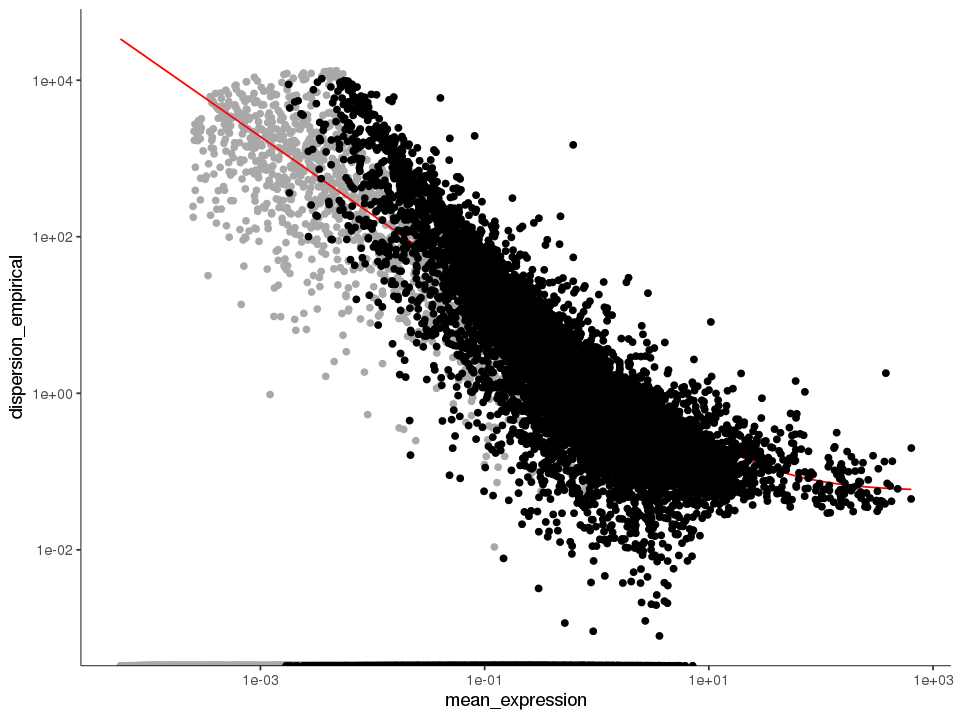

In [72]:
options(repr.plot.width=8, repr.plot.height=6)
plot_ordering_genes(CL10.M)

In [73]:
CL10.M <- reduceDimension(CL10.M, max_components = 2, reduction_method = "DDRTree")

<h4><u>Step3.將細胞按照偽時間排序</u></h4>

In [76]:
CL10.M <- orderCells(CL10.M)

In [80]:
colnames(pData(CL10.M))

[1] "orig.ident"          "nCount_RNA"          "nFeature_RNA"       
 [4] "condition"           "percent.MT"          "RNA_snn_res.0"      
 [7] "RNA_snn_res.0.1"     "RNA_snn_res.0.2"     "RNA_snn_res.0.3"    
[10] "RNA_snn_res.0.4"     "RNA_snn_res.0.5"     "RNA_snn_res.0.6"    
[13] "RNA_snn_res.0.7"     "RNA_snn_res.0.8"     "RNA_snn_res.0.9"    
[16] "RNA_snn_res.1"       "RNA_snn_res.1.1"     "RNA_snn_res.1.2"    
[19] "seurat_clusters"     "S.Score"             "G2M.Score"          
[22] "Phase"               "Size_Factor"         "num_genes_expressed"
[25] "Pseudotime"          "State"

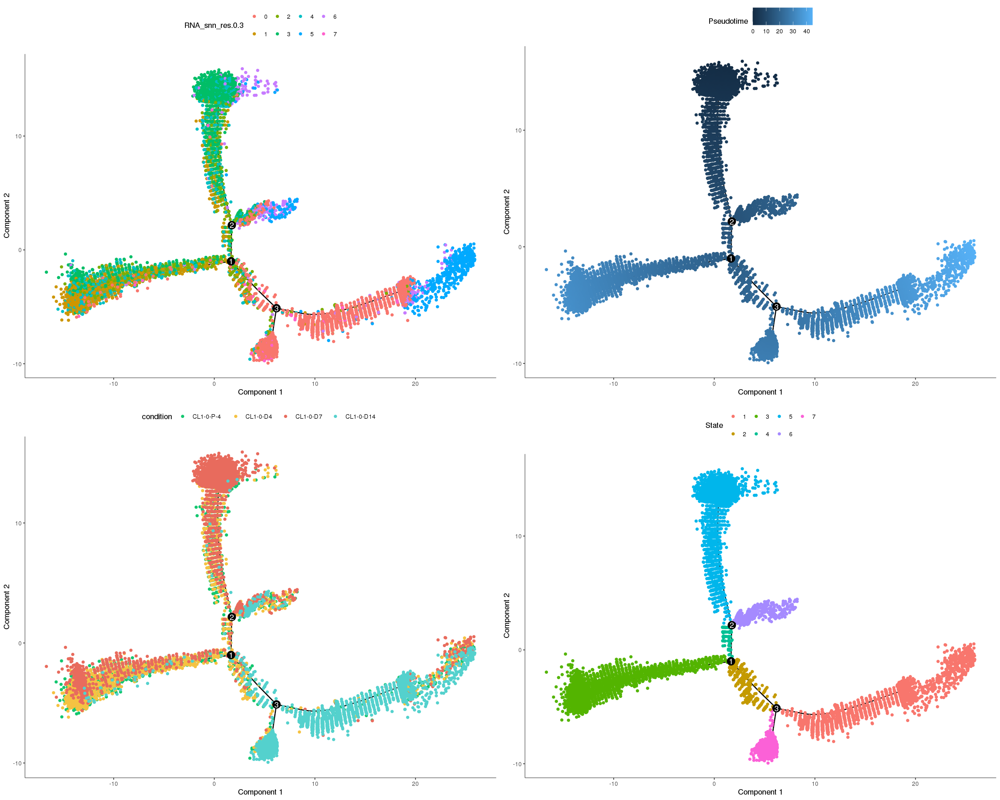

In [5]:
options(repr.plot.width=8, repr.plot.height=8)
GM_state <- function(CL10.M){
  if (length(unique(pData(CL10.M)$State)) > 1){
    T0_counts <- table(pData(CL10.M)$State, pData(CL10.M)$seurat_clusters)[,"0"]
    return(as.numeric(names(T0_counts)[which(T0_counts == max(T0_counts))]))
  } else {
    return (1)
  }
}
CL10.M <- orderCells(CL10.M, root_state = GM_state(CL10.M))

options(repr.plot.width=20, repr.plot.height=16)
trajectoryplot1 <- plot_cell_trajectory(CL10.M, color_by = "RNA_snn_res.0.3")
trajectoryplot2 <- plot_cell_trajectory(CL10.M, color_by = "Pseudotime")
# trajectoryplot2 <- plot_cell_trajectory(CL10.M, color_by = "RNA_snn_res.1.2")
trajectoryplot3 <- plot_cell_trajectory(CL10.M, color_by = "condition") + 
                   scale_color_manual(values = color_style, breaks = order_list)
trajectoryplot4 <- plot_cell_trajectory(CL10.M, color_by = "State", order = order_list, cols = color_style)
plot_grid(trajectoryplot1, trajectoryplot2, trajectoryplot3, trajectoryplot4, ncol=2)

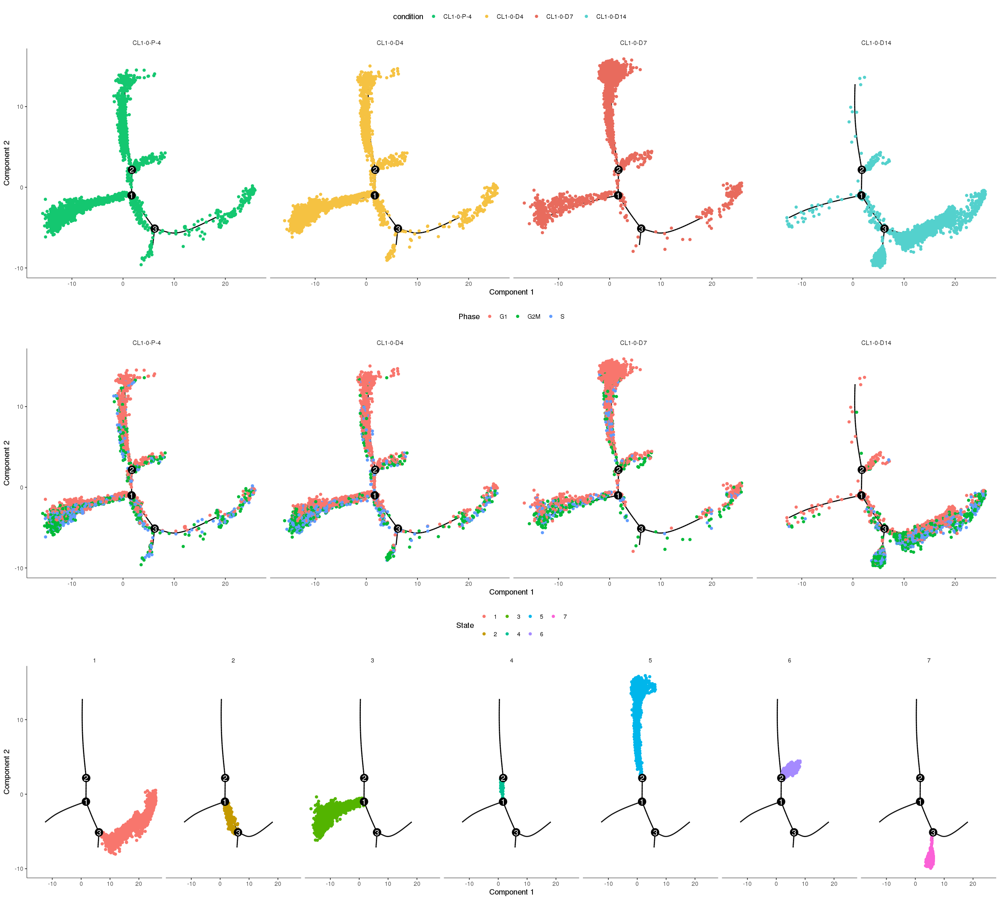

In [189]:
CL10.M@phenoData@data$condition<-factor(CL10.M@phenoData@data$condition, levels = order_list)
options(repr.plot.width=20, repr.plot.height=18)
facet.trajectory.plot1 <- plot_cell_trajectory(CL10.M, color_by = "condition")+
                          scale_color_manual(values = color_style, breaks = order_list)+
                          facet_wrap(~condition, nrow = 1)
facet.trajectory.plot2 <- plot_cell_trajectory(CL10.M, color_by = "Phase")+
                          facet_wrap(~condition, nrow = 1)
facet.trajectory.plot3 <- plot_cell_trajectory(CL10.M, color_by = "State") +
                          facet_wrap(~State, nrow = 1)
plot_grid(facet.trajectory.plot1, facet.trajectory.plot2, facet.trajectory.plot3, ncol=1)

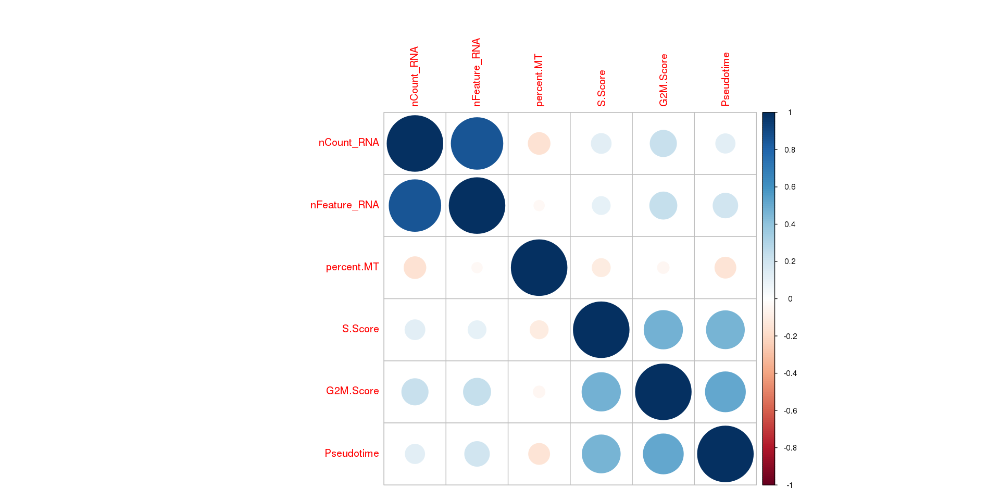

In [9]:
library(corrplot)
options(repr.plot.width = 16, repr.plot.height = 8)
cor.meta <- cor(CL10.M@phenoData@data[, c('nCount_RNA', 'nFeature_RNA', 'percent.MT', 'S.Score', 'G2M.Score', "Pseudotime")], CL10.M@phenoData@data[, c('nCount_RNA',  'nFeature_RNA', 'percent.MT', 'S.Score', 'G2M.Score', "Pseudotime")], method = 'spear')
corrplot(cor.meta, method = "circle")

In [191]:
head(pData(CL10.M))

,orig.ident,nCount_RNA,nFeature_RNA,condition,percent.MT,RNA_snn_res.0,RNA_snn_res.0.1,RNA_snn_res.0.2,RNA_snn_res.0.3,RNA_snn_res.0.4,...,RNA_snn_res.1.1,RNA_snn_res.1.2,seurat_clusters,S.Score,G2M.Score,Phase,Size_Factor,num_genes_expressed,Pseudotime,State
,<chr>,<dbl>,<int>,<fct>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,...,<fct>,<fct>,<fct>,<dbl>,<dbl>,<fct>,<dbl>,<int>,<dbl>,<fct>
AAACCTGAGGATATAC-CL1-0-P-4,Project_1,34903,5160,CL1-0-P-4,6.890525,0,0,0,1,1,...,6,6,6,-0.107436694,0.10028783,G2M,0.8634235,1343,28.224456,3
AAACCTGCACAGTCGC-CL1-0-P-4,Project_1,44235,5270,CL1-0-P-4,3.759466,0,0,1,2,2,...,1,0,0,-0.202336574,-0.29398483,G1,1.0942767,1527,3.808082,5
AAACCTGCACATTTCT-CL1-0-P-4,Project_1,50947,5666,CL1-0-P-4,3.232771,0,0,0,1,1,...,6,6,6,-0.053366337,0.01003614,G2M,1.2603168,1568,13.125445,5
AAACCTGGTTAAAGAC-CL1-0-P-4,Project_1,48822,5704,CL1-0-P-4,4.362787,0,0,0,1,1,...,3,15,15,-0.019682153,0.03967300,G2M,1.2077489,1885,32.241505,3
AAACGGGGTCCCTACT-CL1-0-P-4,Project_1,57224,6412,CL1-0-P-4,2.855445,0,0,0,1,1,...,3,9,9,-0.049966540,0.20111678,G2M,1.4155960,2308,33.090096,3
AAACGGGTCACCATAG-CL1-0-P-4,Project_1,60751,6442,CL1-0-P-4,3.932446,0,0,0,1,1,...,3,15,15,0.007169003,-0.02092221,S,1.5028462,2301,32.863864,3


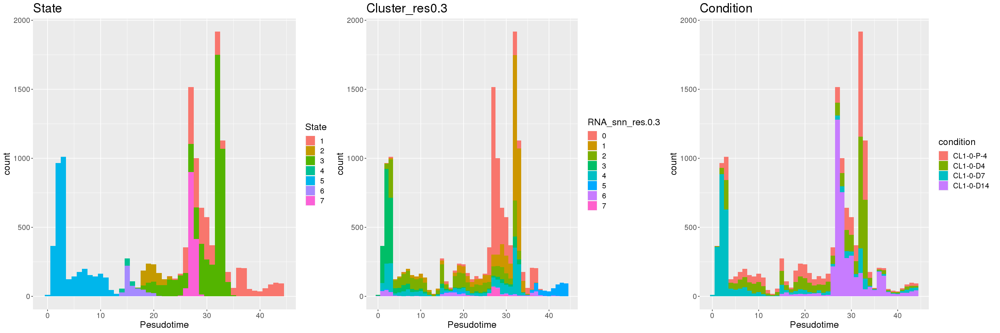

In [223]:
#Plot meta-stable states
options(repr.plot.width=24, repr.plot.height=8)
th1<-ggplot(data=pData(CL10.M), aes(pData(CL10.M)$Pseudotime, fill=State))+
     geom_histogram(binwidth = 1) +
     theme(text = element_text(size = 16), plot.title = element_text(size=22))+
     labs(x="Pesudotime", title="State")
th2<-ggplot(data=pData(CL10.M), aes(pData(CL10.M)$Pseudotime, fill=RNA_snn_res.0.3))+
     geom_histogram(binwidth = 1) +
     theme(text = element_text(size = 16), plot.title = element_text(size=22))+
     labs(x="Pesudotime", title="Cluster_res0.3")
th3<-ggplot(data=pData(CL10.M), aes(pData(CL10.M)$Pseudotime, fill=condition))+
     geom_histogram(binwidth = 1) +
     theme(text = element_text(size = 16), plot.title = element_text(size=22))+
     labs(x="Pesudotime", title="Condition")
plot_grid(th1, th2, th3, ncol=3)

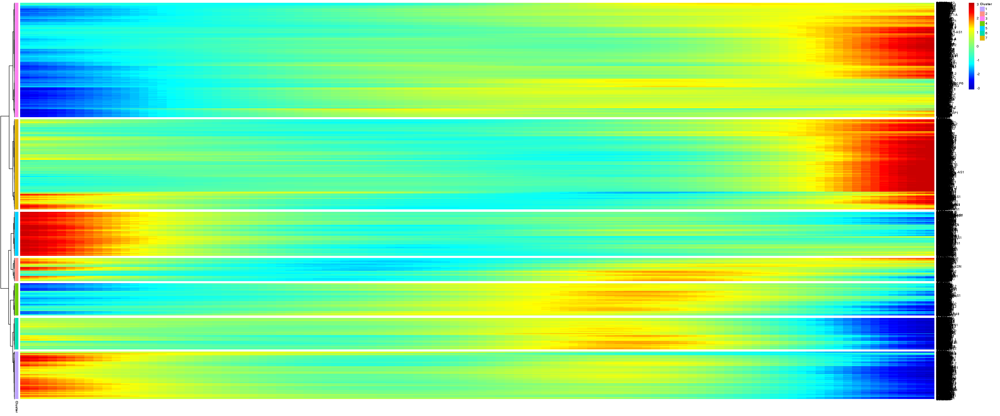

In [231]:
options(repr.plot.width=24, repr.plot.height=10)
plot_pseudotime_heatmap(CL10.M[expressed_genes,],
                        num_clusters = 7,
                        cores = 64,
                        show_rownames = T,
                        use_gene_short_name = T,
                       )

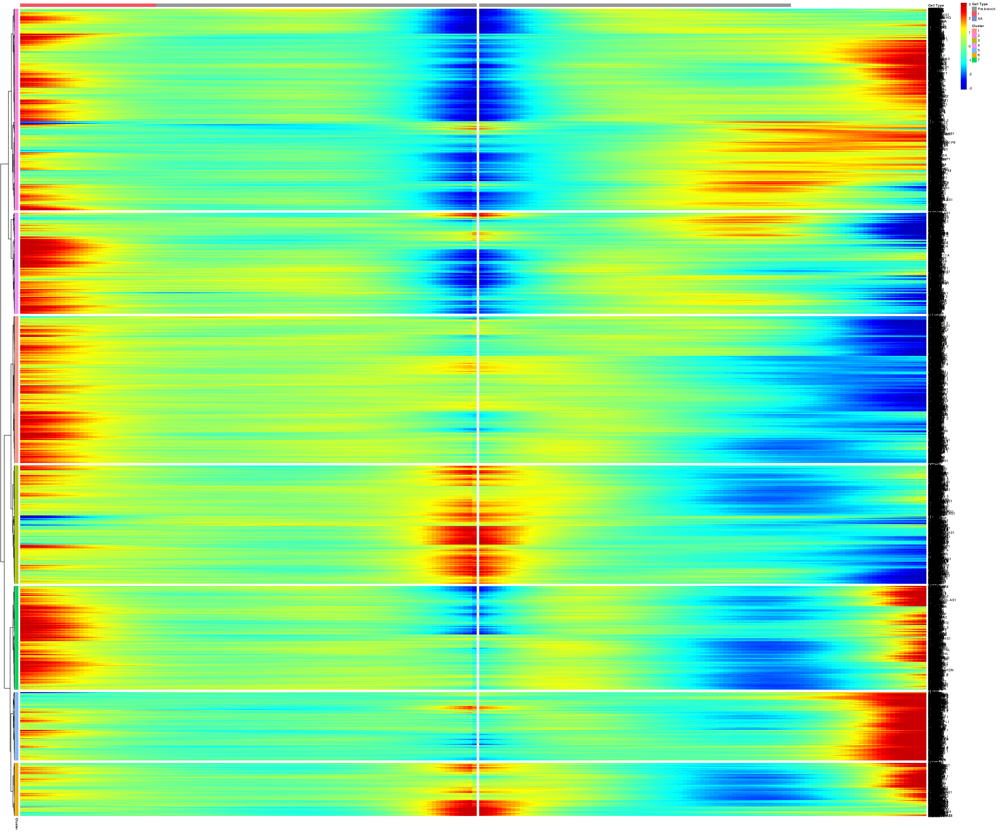

In [230]:
options(repr.plot.width=24, repr.plot.height=20)
plot_genes_branched_heatmap(CL10.M[expressed_genes,],
                            num_clusters = 7,
                            cores = 64,
                            show_rownames = T,
                            use_gene_short_name = T,
                            branch_labels = 1
                           )

In [2]:
#saveRDS(file ="/mnt/isilonX200/scRNA/Project_1/Result/CL1_0_monocle.rds", object = CL10.M)
# CL10.M <- readRDS("/mnt/isilonX200/scRNA/Project_1/Result/CL1_0_monocle.rds")

<h3>Correct Cell Cycle</h3>

In [85]:
# CL10 <- readRDS(file ="/mnt/isilonX200/scRNA/Project_1/Result/CL1_0.rds")
# CL10.M <- readRDS("/mnt/isilonX200/scRNA/Project_1/Result/CL1_0_monocle.rds")

In [ ]:
data <- as(as.matrix(CL10@assays$RNA@counts), 'sparseMatrix')
pd <- new('AnnotatedDataFrame', data = CL10@meta.data)
fData <- data.frame(gene_short_name = row.names(data), row.names = row.names(data))
fd <- new('AnnotatedDataFrame', data = fData)
monocle_cds <- newCellDataSet(data,
                              phenoData = pd,
                              featureData = fd,
                              lowerDetectionLimit = 0.5,
                              expressionFamily = negbinomial.size())
CL10.M.nocc <- monocle_cds
CL10.M.nocc <- estimateSizeFactors(CL10.M.nocc)
CL10.M.nocc <- estimateDispersions(CL10.M.nocc)

CL10.M.nocc <- detectGenes(CL10.M.nocc, min_expr = 3 )

In [125]:
head(fData(CL10.M.nocc)[order(-fData(CL10.M)$num_cells_expressed),])

,gene_short_name,num_cells_expressed
,<fct>,<int>
RPS18,RPS18,14150
RPL13,RPL13,14126
RPS19,RPS19,14124
FTH1,FTH1,14114
RPL41,RPL41,14103
RPS27A,RPS27A,14100


In [129]:
options(mc.cores = 64)
library(future)
plan("multiprocess", workers = 60)
nocc_diff_test_res <- differentialGeneTest(CL10.M.nocc[nocc_expressed_genes], fullModelFormulaStr = "~RNA_snn_res.0.3")


Attaching package: 'future'


The following object is masked from 'package:SummarizedExperiment':

    values


The following object is masked from 'package:GenomicRanges':

    values


The following object is masked from 'package:IRanges':

    values


The following object is masked from 'package:S4Vectors':

    values




In [132]:
head(nocc_diff_test_res)

,status,family,pval,qval,gene_short_name,num_cells_expressed,use_for_ordering
,<fct>,<fct>,<dbl>,<dbl>,<fct>,<int>,<lgl>
AL669831.5,OK,negbinomial.size,5.251291e-64,1.727959e-63,AL669831.5,19,TRUE
SAMD11,OK,negbinomial.size,2.431944e-58,7.350882e-58,SAMD11,3247,TRUE
NOC2L,OK,negbinomial.size,4.109318e-33,8.211693e-33,NOC2L,7624,TRUE
KLHL17,OK,negbinomial.size,5.866874e-04,6.042778e-04,KLHL17,12,TRUE
HES4,OK,negbinomial.size,0.000000e+00,0.000000e+00,HES4,12997,TRUE
ISG15,OK,negbinomial.size,1.120183e-238,1.400906e-237,ISG15,12265,TRUE


In [135]:
nocc_ordering_genes <- row.names (subset(nocc_diff_test_res, qval < 0.01))

In [137]:
length(nocc_ordering_genes)

[1] 8167

In [138]:
CL10.M.nocc <- setOrderingFilter(CL10.M.nocc, nocc_ordering_genes)

In [139]:
expressed_genes <- rownames(subset(fData(CL10.M.nocc), num_cells_expressed >= 10)) 
nocc_expressed_genes <- expressed_genes
for (i in c(cc.genes$s.genes, cc.genes$g2m.genes)){ 
    nocc_expressed_genes <- nocc_expressed_genes[nocc_expressed_genes != i]
}

In [127]:
paste0(length(rownames(fData(CL10.M))), "=>", length(expressed_genes), "=>", length(nocc_expressed_genes))

[1] "33538=>8367=>8279"

In [115]:
igg <- intersect(expressed_genes, c(cc.genes$s.genes, cc.genes$g2m.genes))

Warning message:
"Transformation introduced infinite values in continuous y-axis"
Warning message:
"Transformation introduced infinite values in continuous y-axis"
Warning message:
"Transformation introduced infinite values in continuous y-axis"
Warning message:
"Transformation introduced infinite values in continuous y-axis"
Warning message:
"Transformation introduced infinite values in continuous y-axis"
Warning message:
"Transformation introduced infinite values in continuous y-axis"


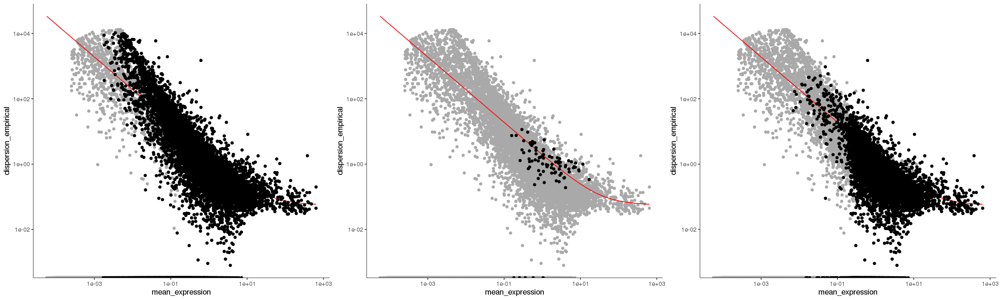

In [227]:
options(repr.plot.width=20, repr.plot.height=6)
pog1 <- plot_ordering_genes(CL10.M)
pog2 <- plot_ordering_genes(CL10.M[igg,])
pog3 <- plot_ordering_genes(CL10.M[nocc_expressed_genes,])
plot_grid(pog1, pog2, pog3, ncol=3)

In [228]:
str(CL10.M)

Formal class 'CellDataSet' [package "monocle"] with 19 slots
  ..@ reducedDimS          : num [1:2, 1:14169] -9.167 -2.764 0.107 12.235 1.2 ...
  .. ..- attr(*, "dimnames")=List of 2
  .. .. ..$ : NULL
  .. .. ..$ : chr [1:14169] "AAACCTGAGGATATAC-CL1-0-P-4" "AAACCTGCACAGTCGC-CL1-0-P-4" "AAACCTGCACATTTCT-CL1-0-P-4" "AAACCTGGTTAAAGAC-CL1-0-P-4" ...
  ..@ reducedDimW          : num [1:13047, 1:2] -1.14e-02 2.88e-05 -5.60e-03 -3.56e-03 -1.56e-03 ...
  ..@ reducedDimA          : num[0 , 0 ] 
  ..@ reducedDimK          : num [1:2, 1:135] -1.28 -1.4 -8.34 -2.61 0.35 ...
  .. ..- attr(*, "dimnames")=List of 2
  .. .. ..$ : NULL
  .. .. ..$ : chr [1:135] "Y_1" "Y_2" "Y_3" "Y_4" ...
  ..@ minSpanningTree      :List of 10
  .. ..$ :List of 1
  .. .. ..$ Y_1: 'igraph.vs' Named int [1:2] 30 61
  .. .. .. ..- attr(*, "names")= chr [1:2] "Y_30" "Y_61"
  .. .. .. ..- attr(*, "env")=<weakref> 
  .. .. .. ..- attr(*, "graph")= chr "e5349976-070f-4e90-9ab5-3e4df95a8d53"
  .. ..$ :List of 1
  .. .. ..$ Y

In [141]:
CL10.M.nocc <- reduceDimension(CL10.M.nocc, max_components = 2, reduction_method = "DDRTree")

In [142]:
CL10.M.nocc <- orderCells(CL10.M.nocc)

In [150]:
length(rownames(pData(CL10.M.nocc)))

[1] 14169

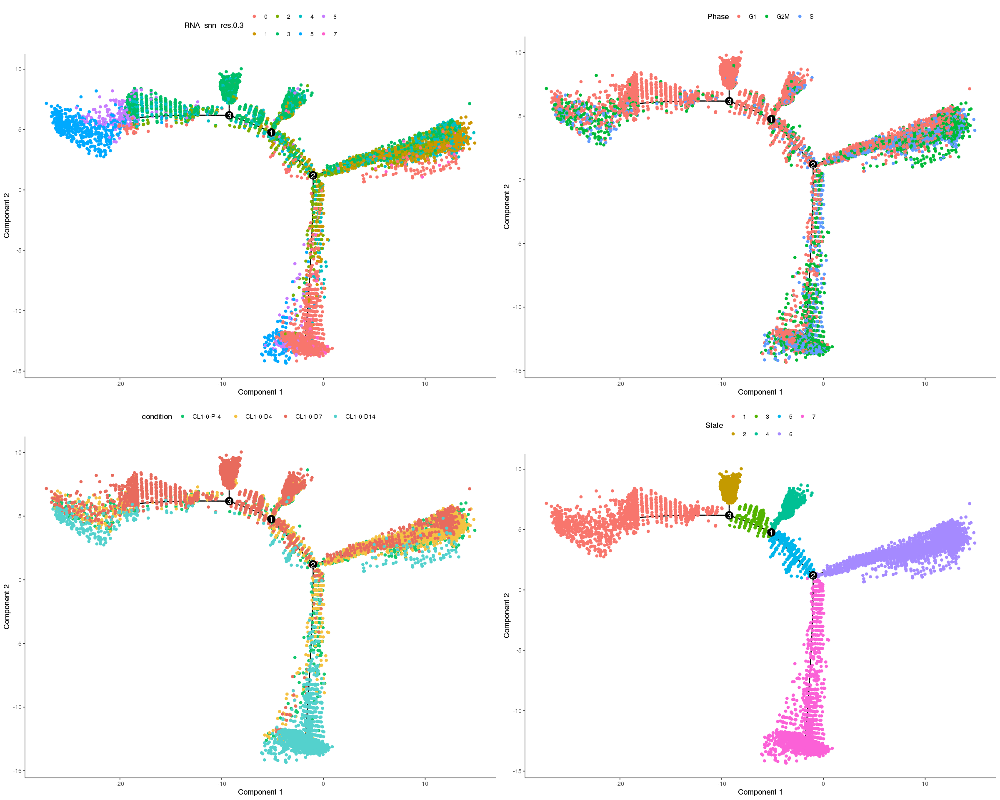

In [161]:
options(repr.plot.width=20, repr.plot.height=16)
trajectoryplot1 <- plot_cell_trajectory(CL10.M.nocc, color_by = "RNA_snn_res.0.3")
trajectoryplot2 <- plot_cell_trajectory(CL10.M.nocc, color_by = "Phase")
trajectoryplot3 <- plot_cell_trajectory(CL10.M.nocc, color_by = "condition") + 
                   scale_color_manual(values = color_style, breaks = order_list)
trajectoryplot4 <- plot_cell_trajectory(CL10.M.nocc, color_by = "State", order = order_list, cols = color_style)
plot_grid(trajectoryplot1, trajectoryplot2, trajectoryplot3, trajectoryplot4, ncol=2)

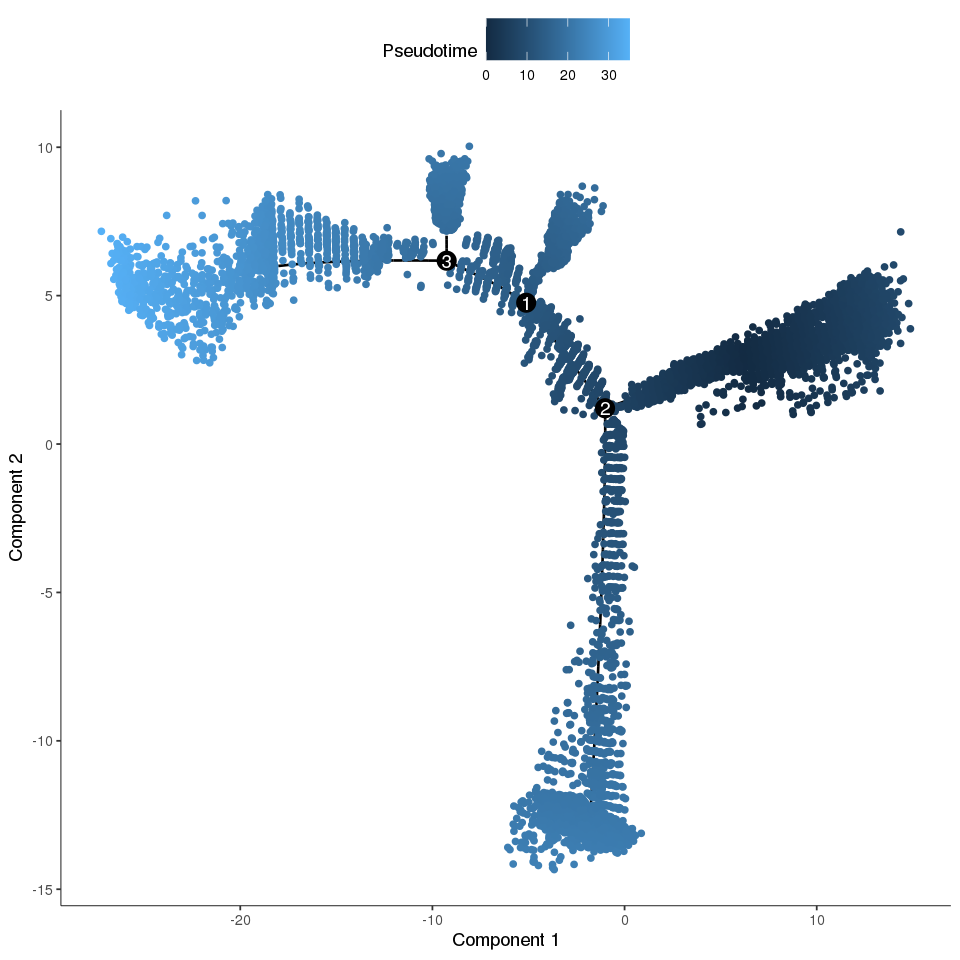

In [163]:
options(repr.plot.width=8, repr.plot.height=8)
GM_state <- function(CL10.M.nocc){
  if (length(unique(pData(CL10.M.nocc)$State)) > 1){
    T0_counts <- table(pData(CL10.M.nocc)$State, pData(CL10.M.nocc)$seurat_clusters)[,"0"]
    return(as.numeric(names(T0_counts)[which(T0_counts == max(T0_counts))]))
  } else {
    return (1)
  }
}
CL10.M.nocc <- orderCells(CL10.M.nocc, root_state = GM_state(CL10.M))
plot_cell_trajectory(CL10.M.nocc, color_by = "Pseudotime")

In [162]:
head(pData(CL10.M.nocc))

,orig.ident,nCount_RNA,nFeature_RNA,condition,percent.MT,RNA_snn_res.0,RNA_snn_res.0.1,RNA_snn_res.0.2,RNA_snn_res.0.3,RNA_snn_res.0.4,...,RNA_snn_res.0.9,RNA_snn_res.1,RNA_snn_res.1.1,RNA_snn_res.1.2,seurat_clusters,Size_Factor,num_genes_expressed,Pseudotime,State,Phase
,<chr>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,...,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<int>,<dbl>,<fct>,<fct>
AAACCTGAGGATATAC-CL1-0-P-4,Project_1,34903,5160,CL1-0-P-4,6.890525,0,0,0,1,1,...,4,3,6,6,1,0.8634235,1343,35.16562,6,G2M
AAACCTGCACAGTCGC-CL1-0-P-4,Project_1,44235,5270,CL1-0-P-4,3.759466,0,0,1,2,2,...,1,1,1,0,2,1.0942767,1527,20.90392,3,G1
AAACCTGCACATTTCT-CL1-0-P-4,Project_1,50947,5666,CL1-0-P-4,3.232771,0,0,0,1,1,...,4,3,6,6,1,1.2603168,1568,24.07713,4,G2M
AAACCTGGTTAAAGAC-CL1-0-P-4,Project_1,48822,5704,CL1-0-P-4,4.362787,0,0,0,1,1,...,6,7,3,15,1,1.2077489,1885,41.19107,6,G2M
AAACGGGGTCCCTACT-CL1-0-P-4,Project_1,57224,6412,CL1-0-P-4,2.855445,0,0,0,1,1,...,4,3,3,9,1,1.4155960,2308,41.97795,6,G2M
AAACGGGTCACCATAG-CL1-0-P-4,Project_1,60751,6442,CL1-0-P-4,3.932446,0,0,0,1,1,...,6,7,3,15,1,1.5028462,2301,41.83543,6,S


<h3><u>Pseudotime DE</u><h3>

In [187]:
CL10@meta.data$RNA_snn_res.1.3 <- pData(CL10.M)$State
CL10 <- FindClusters(CL10, resolution = 1.3)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 14169
Number of edges: 549019

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8061
Number of communities: 24
Elapsed time: 1 seconds


In [189]:
CL10@meta.data$RNA_snn_res.1.3 <- pData(CL10.M)$State

In [176]:
head(CL10[[]])

,orig.ident,nCount_RNA,nFeature_RNA,condition,percent.MT,RNA_snn_res.0,RNA_snn_res.0.1,RNA_snn_res.0.2,RNA_snn_res.0.3,RNA_snn_res.0.4,...,RNA_snn_res.0.8,RNA_snn_res.0.9,RNA_snn_res.1,RNA_snn_res.1.1,RNA_snn_res.1.2,seurat_clusters,S.Score,G2M.Score,Phase,State
,<chr>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,...,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<fct>,<fct>
AAACCTGAGGATATAC-CL1-0-P-4,Project_1,34903,5160,CL1-0-P-4,6.890525,0,0,0,1,1,...,2,4,3,6,6,3,-0.107436694,0.10028783,G2M,3
AAACCTGCACAGTCGC-CL1-0-P-4,Project_1,44235,5270,CL1-0-P-4,3.759466,0,0,1,2,2,...,1,1,1,1,0,5,-0.202336574,-0.29398483,G1,5
AAACCTGCACATTTCT-CL1-0-P-4,Project_1,50947,5666,CL1-0-P-4,3.232771,0,0,0,1,1,...,2,4,3,6,6,5,-0.053366337,0.01003614,G2M,5
AAACCTGGTTAAAGAC-CL1-0-P-4,Project_1,48822,5704,CL1-0-P-4,4.362787,0,0,0,1,1,...,5,6,7,3,15,3,-0.019682153,0.03967300,G2M,3
AAACGGGGTCCCTACT-CL1-0-P-4,Project_1,57224,6412,CL1-0-P-4,2.855445,0,0,0,1,1,...,5,4,3,3,9,3,-0.049966540,0.20111678,G2M,3
AAACGGGTCACCATAG-CL1-0-P-4,Project_1,60751,6442,CL1-0-P-4,3.932446,0,0,0,1,1,...,5,6,7,3,15,3,0.007169003,-0.02092221,S,3


In [192]:
Idents(CL10) <- CL10@meta.data$State

In [193]:
CL10.markers <- FindAllMarkers(object = CL10, features = VariableFeatures(CL10)) 
top20 = CL10.markers %>% group_by(cluster) %>% top_n(n = 20, wt = avg_logFC)

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7



In [194]:
MinMax <- function(data, min, max) {
  data2 <- data
  data2[data2 > max] <- max
  data2[data2 < min] <- min
  return(data2)
}

plot_heatmap <- as.data.frame(x = t(as.matrix(x = t(x = GetAssayData(
    object = CL10,
    slot = 'scale.data')[top20$gene ,cells <- colnames(x = CL10)]))))

annotation_col <- CL10@meta.data[,c("condition", "State"), drop = FALSE]
annotation_col <- annotation_col[order(annotation_col$condition, annotation_col$State),]
plot_heatmap <- plot_heatmap[,rownames(annotation_col)]
plot_heatmap <- MinMax(plot_heatmap,-3.5,3.5)
aka3 = list(condition = color_style)

In [208]:
head(top20[top20$cluster==7,])

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,Inf,1,0.993,0,7,LGALS1
0,270.21293,1,0.991,0,7,TPI1
0,117.08600,1,0.990,0,7,RPS17
0,84.21292,1,0.986,0,7,SNRPD1
0,78.16434,1,0.994,0,7,HSP90AB1
0,73.19477,1,0.978,0,7,SEC61G


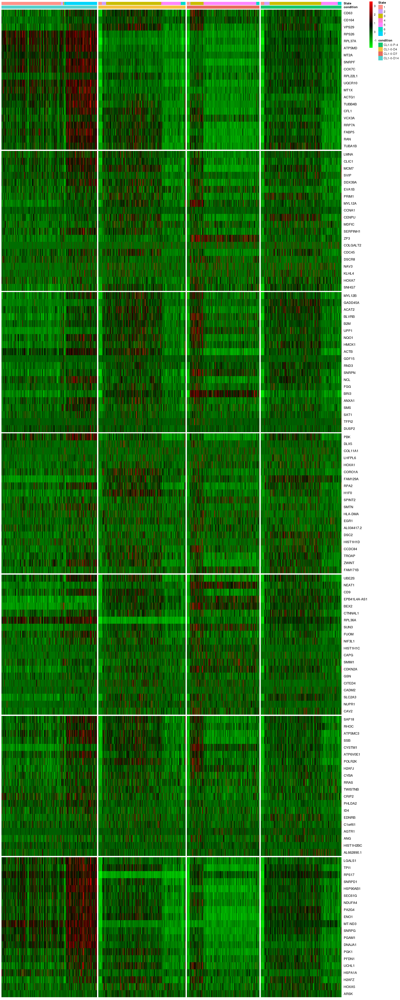

In [213]:
options(repr.plot.width = 18, repr.plot.height = 45)
pheatmap(plot_heatmap,
         annotation_col = annotation_col,
         annotation_colors = aka3[1],
         cluster_rows = FALSE, 
         cluster_cols = FALSE,
         show_colnames = FALSE,
         gaps_row = cumsum(table(top20$cluster)),
         gaps_col = cumsum(table(annotation_col$condition)),
         color = greenred(100),
         fontsize_row=11
         )

In [215]:
#LGALS1:The galectins are a family of beta-galactoside-binding proteins implicated in modulating cell-cell and cell-matrix interactions.  This gene product may act as an autocrine negative growth factor that regulates cell proliferation. 
#TPI1該基因的突變與磷酸丙糖異構酶缺乏有關。